<h1 align="center">Advanced Lane Detection - Project P4</h1>

## Libraries needed

In [2]:
import csv
import cv2
import numpy as np
import sklearn
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline

## Functions 

### Camera Calibration

In [3]:
#################################################################################
#
# runCalibration: generate object and image lists for camera calibration based
#                 on jpg files stored in direction
# inputs:         location = directory where calibration files are stored
#                 nx = number of chess corners in x direction
#                 ny = number of chess corners in y direction
#                 debug = enables debug 0 = no debug, 1 = verbal, 2 = images are 
#                 printed
# outputs:        obj and image list for chess corners as np.array
#
#################################################################################

def runCalibration (location, nx, ny, debug = 0) :
    
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    ref_ob       = np.zeros((nx*ny,3), np.float32)
    ref_ob[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)
    
    # Arrays to store object points and image points from all the images.
    obj_l   = [] # 3d point in real world space
    img_l   = [] # 2d points in image plane.

    # get calibartion files
    images = glob.glob(location)
    
    for fname in images :
        
        # Read & gray scale
        image = mpimg.imread(fname)
        gray  = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
        
        #plt.title('Distorted Image')
        #plt.imshow(image)
        #plt.show()
        
        if (debug == 1) :
            print ('** debug: processing file',fname)
        
        # Find the chess board corners
        ret, corners = cv2.findChessboardCorners(gray,(nx,ny),None)

        # Check if found
        if ret == True :
            obj_l.append(ref_ob)
            img_l.append(corners)
            
            if (debug > 0) :
                print ('** debug: chess corners recognized for file',fname)
            
            if (debug == 2) :
                # plot images
                plt.rcParams["figure.figsize"] = [15, 5]
                sub = plt.subplot(1,2,1)
                plt.title('Distorted Image')
                plt.imshow(image)
                cv2.drawChessboardCorners(image, (nx,ny), corners, ret)
                sub = plt.subplot(1,2,2)
                plt.title('Distorted Image with identified corners')
                plt.imshow(image)
                plt.show()
            
         
    if (len(obj_l) < len(images)) :
        print()
        print('NOTE: not all chess corners have been identified: identified images',len(obj_l),'of',len(images))
        print()
        
    return np.array(obj_l), np.array(img_l)

In [4]:
#################################################################################
#
# runUndistort:   undistort image
# inputs:         name = name of image file
#                 ojb = ref. obj coordinates of chess corners
#                 img = image coordinates of chess corners
#                 debug = enables debug 0 = no debug, 1 = verbal, 2 = images are 
# outputs:        undistorted image
#
#################################################################################

def runUndistort(name, obj, img, debug=0) :

    # Test undistortion on an image
    pic = mpimg.imread(name)
    im_size = (pic.shape[1], pic.shape[0])

    # Do camera calibration given object points and image points
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj, img, im_size,None,None)

    # check distortion
    dst = cv2.undistort(pic, mtx, dist, None, mtx)

    if debug > 0 :
        # plot
        plt.rcParams["figure.figsize"] = [15, 5]
        #pic  = cv2.cvtColor(pic, cv2.COLOR_BGR2RGB)
        sub = plt.subplot(1,2,1)
        plt.title('Original Image')
        plt.imshow(pic)
        sub = plt.subplot(1,2,2)
        plt.title('Undistorted Image')
        #dst  = cv2.cvtColor(dst, cv2.COLOR_BGR2RGB)
        plt.imshow(dst)
        plt.show()
    
    return dst

### Image Pre-processing

#### Sobel

In [5]:
#################################################################################
#
# sobel functions (from training sessions):  
#                                          abs_sobel_thresh
#                                          mag_thresh
#                                          dir_threshold
#
# inputs:         image in RGB
#                 ....
# outputs:        image in grayscale
#
#################################################################################

def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(80, 255)):  
    
    # color convert 
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # set x or y
    if orient == 'x' :
        x=1
        y=0
    else :
        x=0
        y=1
    sobel = cv2.Sobel(gray,cv2.CV_64F,x,y)
    # absolute value of the derivative or gradient
    sobel_abs = np.absolute(sobel)
    # Scale to 8-bit (0 - 255) then convert to type = np.uint8
    sobel_scaled = np.uint8(255*sobel_abs/np.max(sobel_abs))
    # Create a mask of 1's where the scaled gradient magnitude 
    binary_output = np.zeros_like(sobel_scaled)    
    # Apply threshold
    binary_output[(sobel_scaled >= thresh[0]) & (sobel_scaled <= thresh[1])] = 1
    # return
    return binary_output


def mag_thresh(img, sobel_kernel=3, mag_thresh=(30, 100)):
    
    # color convert
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    # Calculate the magnitude 
    mag = (sobel_x**2 + sobel_y**2)**0.5
    # Scale to 8-bit (0 - 255) and convert to type = np.uint8
    mag_scaled = np.uint8(255*mag/np.max(mag))
    # Create a mask of 1's where the scaled gradient magnitude 
    binary_output = np.zeros_like(mag_scaled)
    # Apply threshold
    binary_output[(mag_scaled >= mag_thresh[0]) & (mag_scaled <= mag_thresh[1])] = 1
    # return
    return binary_output
    
    
def dir_threshold(img, sobel_kernel=3, thresh=(0.7, 1.3)):
    # Convert to grayscale
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
    # Take the gradient in x and y separately
    sobel_x = cv2.Sobel(gray,cv2.CV_64F,1,0,ksize=sobel_kernel)
    sobel_y = cv2.Sobel(gray,cv2.CV_64F,0,1,ksize=sobel_kernel)
    # Take the absolute value of the x and y gradients
    mag = (sobel_x**2 + sobel_y**2)**0.5
    # Use np.arctan2(abs_sobely, abs_sobelx) to calculate the direction of the gradient 
    direction = np.arctan2(np.absolute(sobel_y),np.absolute(sobel_x))
    # Create a mask of 1's where the scaled gradient magnitude 
    binary_output = np.zeros_like(direction)
    # Apply threshold
    binary_output[(direction >= thresh[0]) & (direction <= thresh[1])] = 1
    # return
    return binary_output
   

#### Color Convertion

In [6]:
#################################################################################
#
# color convertion functions (from training sessions):  
#                                          hls_select
# inputs:         image in RGB
#                 ....
# outputs:        image in grayscale
#
#################################################################################

def hls_select(img, thresh=(0, 255)):
    # Convert to HLS color space
    hls = cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    # Apply a threshold to the S channel
    S = hls[:,:,2]
    # Threshold 
    binary_output = np.zeros_like(S)
    binary_output[(S >= thresh[0]) & (S <= thresh[1])] = 1

    return binary_output

#### Combination of Color Convertion & Sobel

In [7]:
#################################################################################
#
# combined color convertion + sobel functions (from training sessions): 
#                                                    combinedSobelColor()
#                                                    combinedAdvanced()
#                                                    combinedAdvanced2() used !!
#                                          
# inputs:         image in RGB
#                 ....
# outputs:        binary image
#
#################################################################################


def combinedSobelColor (img, kernel=3, thresh_s=(20,100), thresh_c=(125,255)) :
  
    sxbinary = abs_sobel_thresh(img, orient='x', sobel_kernel=kernel, thresh=thresh_s)
    sbinary  = hls_select(img, thresh=thresh_c)

    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, sbinary))

    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(sbinary == 1) | (sxbinary == 1)] = 1

    return combined_binary



def combinedAdvanced(img, s_thresh=(155, 255), sx_thresh=(25, 155)):
    
    img = np.copy(img)
    
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    
    #return color_binary

    combined_binary = np.zeros_like(sxbinary)
    combined_binary[(s_binary == 1) | (sxbinary == 1)] = 1

    return combined_binary


def combinedAdvanced2(img, s_thresh=(155, 255), sx_thresh=(50, 255), l_thresh=(40,255)):
    
    img = np.copy(img)
    
    # Convert to HSV color space and separate the V channel
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    
    # Sobel x
    sobelx = cv2.Sobel(l_channel, cv2.CV_64F, 1, 0,ksize=3) # Take the derivative in x
    abs_sobelx = np.absolute(sobelx) # Absolute x derivative to accentuate lines away from horizontal
    scaled_sobel = np.uint8(255*abs_sobelx/np.max(abs_sobelx))
    
    # Threshold x gradient
    sxbinary = np.zeros_like(scaled_sobel)
    sxbinary[(scaled_sobel >= sx_thresh[0]) & (scaled_sobel <= sx_thresh[1])] = 1
    
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= s_thresh[0]) & (s_channel <= s_thresh[1])] = 1
    
    # Threshold lightness
    l_binary = np.zeros_like(l_channel)
    l_binary[(l_channel >= l_thresh[0]) & (l_channel <= l_thresh[1])] = 1
    
    #color_binary = np.dstack(( np.zeros_like(sxbinary), sxbinary, s_binary))
    combined_binary = np.zeros_like(sxbinary)
    combined_binary[((s_binary == 1) & (l_binary == 1)) | (sxbinary == 1)] = 1
    
    return combined_binary

### Perspective Matrix 

#### Some functions used @ Lane Detection Project P1

In [8]:
#################################################################################
#
# functions used in P1 project:
#                                 region_of_interest()
#                                 filterlines()
#
#################################################################################

def region_of_interest(img, vertices):
    """
    Applies an image mask.
    
    Only keeps the region of the image defined by the polygon
    formed from `vertices`. The rest of the image is set to black.
    """
    #defining a blank mask to start with
    mask = np.zeros_like(img)   
    
    #defining a 3 channel or 1 channel color to fill the mask with depending on the input image
    if len(img.shape) > 2:
        channel_count = img.shape[2]  # i.e. 3 or 4 depending on your image
        ignore_mask_color = (255,) * channel_count
    else:
        ignore_mask_color = 255
        
    #filling pixels inside the polygon defined by "vertices" with the fill color    
    cv2.fillPoly(mask, vertices, ignore_mask_color)
    
    #returning the image only where mask pixels are nonzero
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image


def filterlines (lines, miny, maxy) :
    
    new_lines = []
    
    LTH       = -0.5
    RTH       =  0.5
    
    x1_lm     = 0
    y1_lm     = 0
    slope_lm  = 0
    num_l     = 0
    
    x1_rm     = 0
    y1_rm     = 0
    slope_rm  = 0
    num_r     = 0
    
    X1R       = 0
    X2R       = 0
    X1L       = 0
    X2L       = 0
    
    # go through all lines
    for line in lines :
        
        for x1,y1,x2,y2 in line :
            
            # Calculate slope
            slope = ((y2-y1)/(x2-x1)) 
            
            #print ('** slope',slope,'x1,y1',x1,y1,'x2,y2',x2,y2)
            
            # left slope
            if slope < LTH :
                
                # incr. left number
                num_l = num_l +1
                # mean values
                x1_lm    = x1_lm + x1 
                y1_lm    = y1_lm + y1 
                slope_lm = slope_lm + slope
                
            else :
                if slope > RTH :
                    
                    # incr. left number
                    num_r = num_r +1
                    # mean values
                    x1_rm    = x1_rm + x1 
                    y1_rm    = y1_rm + y1 
                    slope_rm = slope_rm + slope
                    
                else :
                    break
            
    # calulate 
    if num_l > 0 :
       # calculate mean     
        x1_lm    = int(x1_lm / num_l)
        y1_lm    = int(y1_lm / num_l)
        slope_lm = (slope_lm / num_l)
        #print ('left',x1_lm,y1_lm,slope_lm,num_l)
        # calculate x values
        X1L      = int (((maxy - y1_lm) / slope_lm ) + x1_lm)
        X2L      = int (((miny - y1_lm) / slope_lm ) + x1_lm)
    
    if num_r > 0 :
        # calculate mean
        x1_rm    = int(x1_rm / num_r)
        y1_rm    = int(y1_rm / num_r)
        slope_rm = (slope_rm / num_r)
        #print ('right',x1_rm,y1_rm,slope_rm,num_r)
        # calculate x values
        X1R      = int (((maxy - y1_rm) / slope_rm ) + x1_rm)
        X2R      = int (((miny - y1_rm) / slope_rm ) + x1_rm)
    
    return X1L, X2L, X1R, X2R

#### Perspective Marix generation

In [9]:
################################################################################
#
# Region parameters & Hough transformation parametere 
#
#################################################################################

def runPerspectiveMatrix (image, debug = 0) :
    
    # reference image shape
    imshape = image.shape
    # color covert
    image_p    = combinedSobelColor(image,thresh_s=(60,120), thresh_c=(155,255))

    # region variables
    VIEW_y  = 480        # max y value  # 480
    VIEW_l  = 400       
    VIEW_r  = 800
    MAX_y   = imshape[0] # height
    MIN_x   = 0
    MAX_x   = imshape[1] # width

    # set region
    region       = np.array([[(MIN_x,MAX_y),(VIEW_l, VIEW_y), (VIEW_r, VIEW_y), (MAX_x,MAX_y)]], dtype=np.int32)
    masked_edges = region_of_interest(image_p, region)

    # hough tranformation
    votes  = 40
    lines  = cv2.HoughLinesP(masked_edges, 1, (np.pi/180), votes, np.array([]), minLineLength=10, maxLineGap=10)

    # draw lines
    color=[255, 0, 0] 
    thickness=2

    # get coordinates
    x1, x2, x3, x4 = filterlines (lines, VIEW_y, MAX_y )

    line_img = np.zeros((image_p.shape[0], image_p.shape[1], 3), dtype=np.uint8)

    cv2.line(line_img, (x1, MAX_y),       (x2, VIEW_y), color, thickness)
    cv2.line(line_img, (x3, MAX_y),       (x4, VIEW_y), color, thickness)
    cv2.line(line_img, (x1, MAX_y),       (x3, MAX_y),  color, thickness)
    cv2.line(line_img, (x2, VIEW_y),      (x4, VIEW_y), color, thickness)

    # mkae copy of ref. images + add lines drawing
    img_c = np.copy(image)
    rst   = cv2.addWeighted(img_c, 0.7, line_img, 1.0, 0.0)
    
    # plot rst
    if (debug > 1) :
        plt.imshow(rst)
        plt.show()
        
        
    # generate matrix & warped image
    
    # set source and destination array
    src = np.array( [ (x1, MAX_y), (x2, VIEW_y), (x4, VIEW_y), (x3, MAX_y) ],np.float32) 
    dst = np.array( [ (x1, MAX_y), (x1, 0),      (x3, 0),      (x3, MAX_y) ],np.float32)

    # Matrix 
    M    = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)

    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(rst, M, (rst.shape[1],rst.shape[0]))
    
    # plot verification of warped image
    if (debug > 0) :
        
        print ("NOTE: SRC coordinates=")
        print (src)
        print ("NOTE: DST coordinates=")
        print (dst)
        print ("NOTE: lane width [pixels]=",x3-x1)
        
        plt.rcParams["figure.figsize"] = [24, 12]
        sub = plt.subplot(2,2,1)
        plt.title('Original')
        plt.imshow(rst)
        sub = plt.subplot(2,2,2)
        plt.title('Transformed Bird View')
        plt.imshow(warped) 
        plt.show()

    return M, Minv

### Pipeline functions

#### 1. Lane Detection

In [10]:
#################################################################################
#
# laneDetectSlide:  searches full 2. poly. for left and right lanes using sliding 
#
# inputs:         image (binary)
#                 nwindow = number of windows to search
#                 margin  = x width for search @ each line
#                 minpix  = min. pixels in asearch window 
#                 ym_per_pix = y meter per pixel coefficient
#                 xm_per_pix = x meter per pixel coefficient
#                 debug = if bigger than 1 histogram, search plots will be displayed 
# 
# outputs:        2. poly. for left and right lane
#                 curve radius for left and right lane
#
#################################################################################

def laneDetectSlide (image, nwindows = 9, margin = 100, minpix = 50, ym_per_pix = 30/720, xm_per_pix = 3.7/900, debug = 0) :
    
    # get positions
    histogram   = np.sum(image[image.shape[0]//2:,:], axis=0)
    midpoint    = np.int(histogram.shape[0]/2)
    leftx_base  = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint
     # window height to slide
    window_height = np.int(image.shape[0]/nwindows)
    
    # silding windows image - only needed if ploting enabled
    if (debug > 0) :
        out_img = np.dstack((image, image, image))*255     
    
    # x and y values
    nonzero  = image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    # start positions
    leftx_current  = leftx_base
    rightx_current = rightx_base
    
    # lane indexes
    left_lane_inds = []
    right_lane_inds = []
    
    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low       = image.shape[0] - (window+1)*window_height
        win_y_high      = image.shape[0] -  window*window_height
        win_xleft_low   = leftx_current - margin
        win_xleft_high  = leftx_current + margin
        win_xright_low  = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image if enabled
        if (debug > 0) :
            cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
            cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
    
        # Identify the nonzero pixels in x and y within the window
        good_left_inds  = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
    
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
      
    # flatten indexes
    left_lane_inds  = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx  = nonzerox[left_lane_inds]
    lefty  = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # plot 
    if (debug > 0) :
        
        # Generate x and y values for plotting
        ploty = np.linspace(0, image.shape[0]-1, image.shape[0] )
        left_fitx  = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        # Sliding window
        
        out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
        out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
       
        plt.rcParams["figure.figsize"] = [18, 9]
        # plot also histogram
        sub = plt.subplot(1,1,1)
        histogram = np.sum(image[image.shape[0]//2:,:], axis=0)
        plt.plot(histogram)   
        plt.show() 
        
        # sliding 
        plt.rcParams["figure.figsize"] = [18, 9]
        sub = plt.subplot(1,1,1)
        plt.title('Lane Detection - Sliding Approach')
        plt.imshow(out_img)
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show() 
        
        # detected lines
        ub = plt.subplot(1,1,1)
        plt.title('Detected Lanes')
        plt.imshow(image,cmap = 'gray')
        plt.plot(left_fitx, ploty, color='yellow')
        plt.plot(right_fitx, ploty, color='yellow')
        plt.xlim(0, 1280)
        plt.ylim(720, 0)
        plt.show()
       
       
    # calculate radius
    # Fit new polynomials to x,y in world space
    left_fit_cr  =  np.polyfit(lefty  * ym_per_pix, leftx  * xm_per_pix, 2)
    right_fit_cr =  np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad  = ((1 + (2*left_fit_cr[0] * 719*ym_per_pix + left_fit_cr[1])**2)**1.5) /  np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]* 719*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])

    
    return left_fit, right_fit, left_curverad, right_curverad

In [11]:
#################################################################################
#
# laneDetectReuse:  searches full 2. poly. for left and right lanes using last poly 
#
# inputs:         image (binary)
#                 left_fit, right_fit = last 2. poly. for left and right lane
#                 nwindow = number of windows to search
#                 margin  = x width for search @ each line
#                 ym_per_pix = y meter per pixel coefficient
#                 xm_per_pix = x meter per pixel coefficient 
# 
# outputs:        2. poly. for left and right lane
#                 curve radius for left and right lane
#
#################################################################################

def laneDetectReuse (image, left_fit, right_fit, margin = 100,ym_per_pix = 30/720, xm_per_pix = 3.7/900) :
    
    # get pix
    nonzero =  image.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])

    # search
    left_lane_inds  =  ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin))) 
    
    # Again, extract left and right line pixel positions
    leftx  = nonzerox[left_lane_inds]
    lefty  = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit  = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # calculate radius
    # Fit new polynomials to x,y in world space
    left_fit_cr  =  np.polyfit(lefty  * ym_per_pix, leftx  * xm_per_pix, 2)
    right_fit_cr =  np.polyfit(righty * ym_per_pix, rightx * xm_per_pix, 2)
    
    # Calculate the new radii of curvature
    left_curverad  = ((1 + (2*left_fit_cr[0] * 719*ym_per_pix + left_fit_cr[1])**2)**1.5) /  np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]* 719*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return left_fit, right_fit, left_curverad, right_curverad

In [12]:
################################################################################
#
# centerOffset_m: cal. vehicle position versus image center 
#
# inputs:         left_fit, right_fit = last 2. poly. for left and right lane
#                 width = image width
#                 height = image height
#                 xm_per_pix = x meter per pixel coefficient
# outputs:        position in meters
#
#################################################################################

def centerOffset_m (left_fit, right_fit, width=1280, height=720, lane_mp=3.7/900) :

    xl =  left_fit[0]*height**2 +  left_fit[1]*height + left_fit[2]
    xr = right_fit[0]*height**2 + right_fit[1]*height + right_fit[2]

    lane_center = (xr+xl)/2
    pic_center  =  width/2
    offset      =  lane_center - pic_center
        
    return offset * lane_mp

In [13]:
#################################################################################
#
# unWarp:   unwarps warp image and generates image with lane detection area 
#
# inputs:   image = orig. image (color) 
#           warp  = warped image
#           Minv  = inverse Matrix for unwarping
#           left_fit, right_fit = last 2. poly. for left and right lane
#
# outputs:  image with lane detection area
#
#################################################################################

def drawLaneArea(image, warp, Minv, left_fit, right_fit ) :

    # plot pixels
    ploty = np.linspace(0, warp.shape[0]-1, warp.shape[0] )
    left_fitx  = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    warp_zero  = np.zeros_like(warp).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left  = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (image.shape[1], image.shape[0])) 

    # Combine the result with the original image
    result = cv2.addWeighted(image, 1, newwarp, 0.3, 0)
        
    return result

In [79]:
#################################################################################
#
# pipeLine: main processing pipeline 
#
# inputs:   image = orig. image (color) 
#           Minv  = Matrix & inverse Matrix for warping
#           obj_l, img_l = chessboard corner list for ref. and image (used for undistort)
#           number = image number
#           debug = if enbale plots results
#
# NOT USED
# globals   reset = if asserted == 1: only laneDetectionSlide runs for detection
#           before_left_fit_buf, before_right_fit_buf 0 circular buffer for saving poly. results
#           before_left_fit, before_right_fit = last ploy fit for left and right lane
#
# outputs:  image prcessed after lane detection
#
#################################################################################

import collections

before_left_fit  = None
before_right_fit = None

reset = 1

before_left_fit_buf  = collections.deque(maxlen=10)
before_right_fit_buf = collections.deque(maxlen=10)


def pipeLine(image, M, Minv, obj_l, img_l, number, debug = 0) :
    
    global before_left_fit_buf
    global before_right_fit_buf
    global before_left_fit
    global before_right_fit
    global reset
    
    if (number == 1) :
        print ('NOTE: combinedAdvanced2(image_und,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(40,255)) ')
   
    # 1. undistort image
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(obj_l, img_l, (image.shape[1], image.shape[0]),None,None)
    image_und                    = cv2.undistort(image, mtx, dist, None, mtx)
    
    # 2. image pre-process  3
    warped_ = combinedAdvanced2(image_und,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(40,255)) 
  
    
    # 3. warp image
    warped_pre    = cv2.warpPerspective(warped_, M, (image.shape[1],image.shape[0]))
    
    # show steps 2. & 3.
    if (debug > 0) :
        
        plt.rcParams["figure.figsize"] = [24, 12]
        sub = plt.subplot(2,2,1)
        plt.title('Pre-processed Image')
        plt.imshow(warped_,cmap='gray')
        sub = plt.subplot(2,2,2)
        plt.title('Binary Warped Image')
        plt.imshow(warped_pre,cmap='gray')
        plt.show()
        
    
    # 4. lane detection
    
    if (reset == 1) :
        # last one was bad - therefore sliding approach or always 
        print ('NOTE: reset @ frame =',number)
        left_fit_, right_fit_, curve_left_, curve_right_ = laneDetectSlide(warped_pre,margin = 100, debug = debug)
    else :
        left_fit_, right_fit_, curve_left_, curve_right_ = laneDetectReuse(warped_pre,before_left_fit,before_right_fit,margin = 100)
    
    
    # Sensivity check 1 
    if left_fit_ == None or right_fit_ == None :
        print ('FATAL: no lane detected @ frame =',number)
        reset = 1
        left_fit_  = sum(before_left_fit_buf)/len(before_left_fit_buf)
        right_fit_ = sum(before_right_fit_buf)/len(before_left_fit_buf)
    
    # senitiy check: check that the lane width (900 pixels) is between */- 12% 
    x_pos_left     =  left_fit_[0]*719**2 +  left_fit_[1]*719 + left_fit_[2]
    x_pos_right    = right_fit_[0]*719**2 + right_fit_[1]*719 + right_fit_[2]
    lane_width_cal = x_pos_right - x_pos_left 
  
    if (lane_width_cal < 765 or lane_width_cal > 1035) :  
        print ('NOTE: lane width issue =',lane_width_cal,'@ frame =',number)
        left_fit_  = sum(before_left_fit_buf)/len(before_left_fit_buf)
        right_fit_ = sum(before_right_fit_buf)/len(before_left_fit_buf)
        reset = 1
    else : 
        # save old value
        before_left_fit_buf.append(left_fit_)
        before_right_fit_buf.append(right_fit_)
        reset = 0 # if 1 only sliding apporach
    
    before_left_fit  = np.copy(left_fit_)
    before_right_fit = np.copy(right_fit_)
               
               
    # 5. draw lane 
    result_ = drawLaneArea(image_und, warped_pre, Minv, left_fit_, right_fit_)
    
    # 6. Add curve & centre info
            
    # add curve + offset info
    av = np.copy(np.abs(curve_right_ + curve_left_))
    radius = int(av / 2)
               
    curve_text  = "Curvature Radius:%6.im" %  ( radius )
    offset_text = "Vehicle Position:   %.3fm"  %  ( centerOffset_m (left_fit_, right_fit_) )
    
    cv2.putText(result_,curve_text,    (100,100), cv2.FONT_HERSHEY_DUPLEX,  1,  (255,255,255) )
    cv2.putText(result_,offset_text,   (100,140), cv2.FONT_HERSHEY_DUPLEX,  1,  (255,255,255) )
               
        
    return result_
    

## A. Calibrate Camera - Chessboard Corners

### Chessboard corners

** debug: chess corners recognized for file ./camera_cal/calibration10.jpg


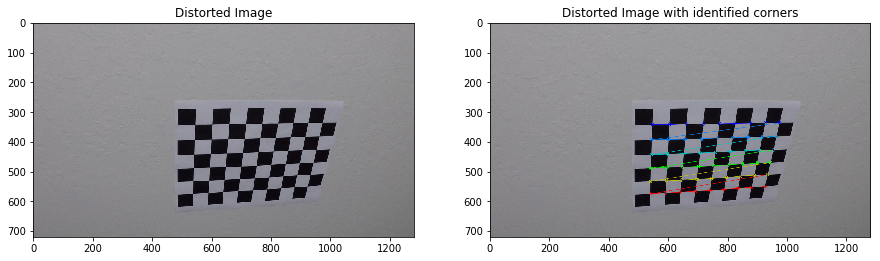

** debug: chess corners recognized for file ./camera_cal/calibration11.jpg


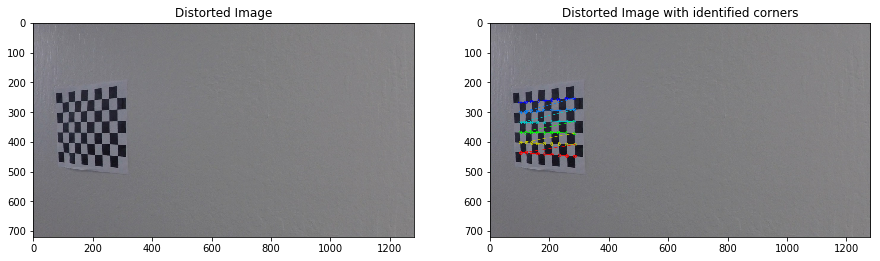

** debug: chess corners recognized for file ./camera_cal/calibration12.jpg


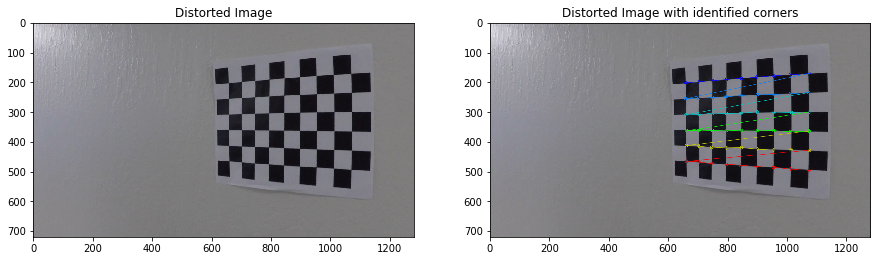

** debug: chess corners recognized for file ./camera_cal/calibration13.jpg


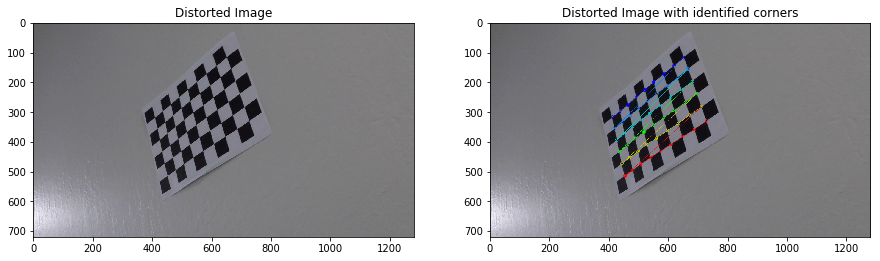

** debug: chess corners recognized for file ./camera_cal/calibration14.jpg


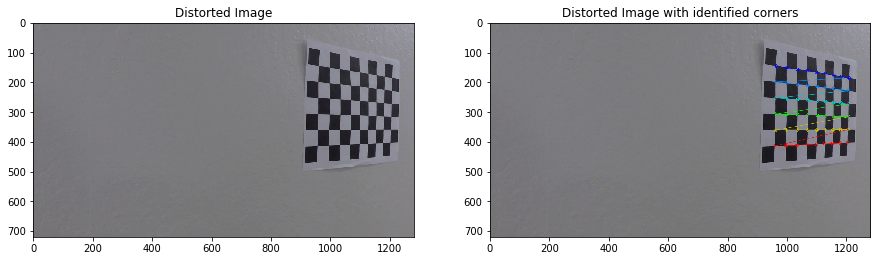

** debug: chess corners recognized for file ./camera_cal/calibration15.jpg


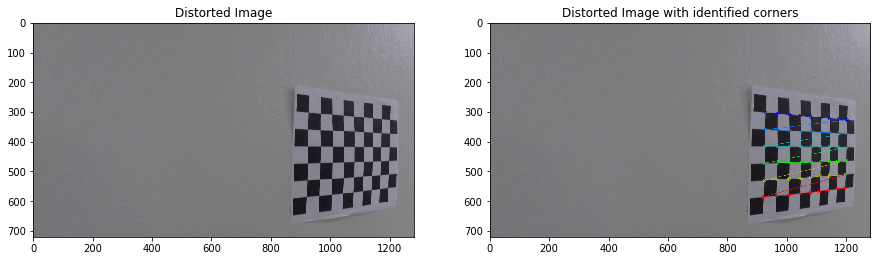

** debug: chess corners recognized for file ./camera_cal/calibration16.jpg


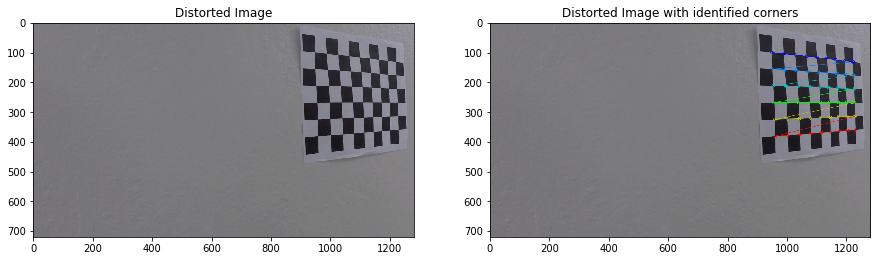

** debug: chess corners recognized for file ./camera_cal/calibration17.jpg


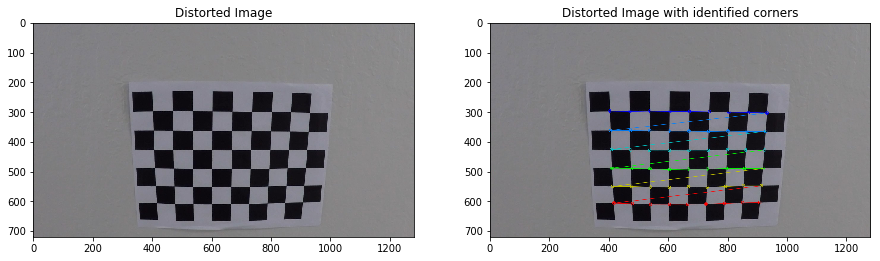

** debug: chess corners recognized for file ./camera_cal/calibration18.jpg


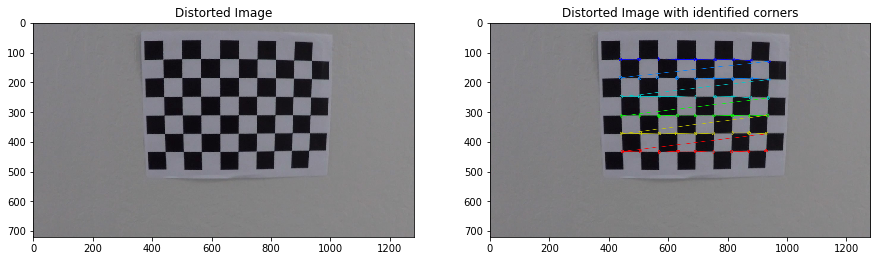

** debug: chess corners recognized for file ./camera_cal/calibration19.jpg


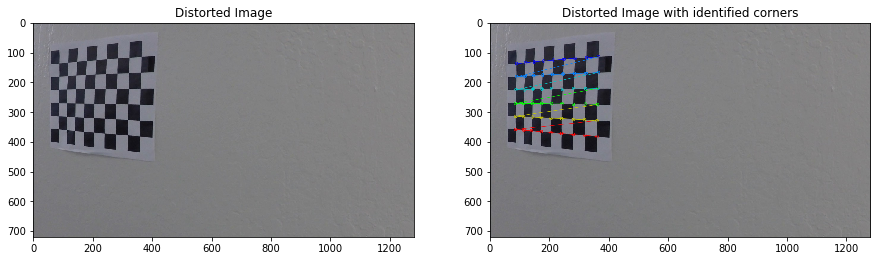

** debug: chess corners recognized for file ./camera_cal/calibration2.jpg


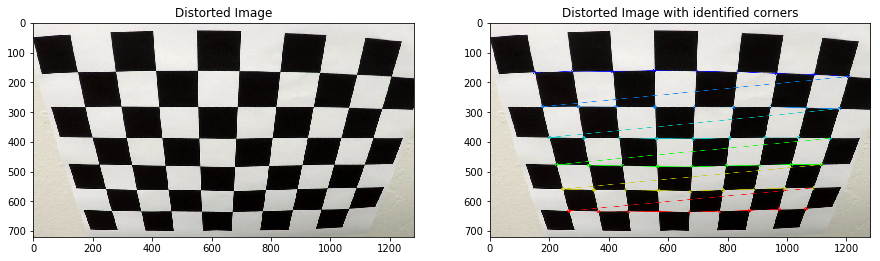

** debug: chess corners recognized for file ./camera_cal/calibration20.jpg


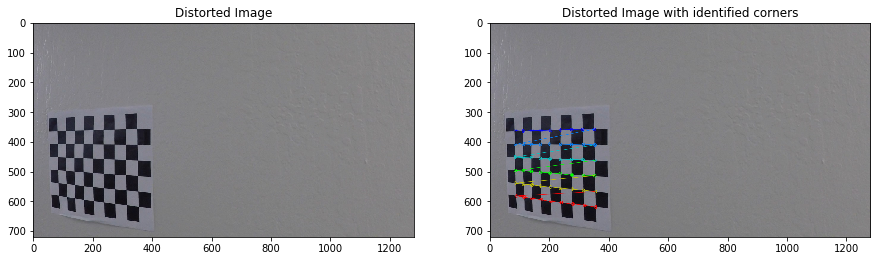

** debug: chess corners recognized for file ./camera_cal/calibration3.jpg


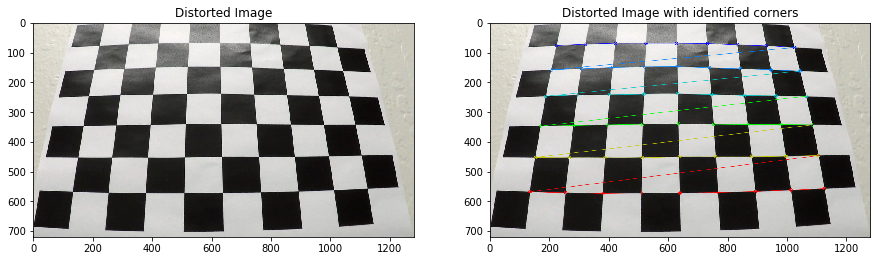

** debug: chess corners recognized for file ./camera_cal/calibration6.jpg


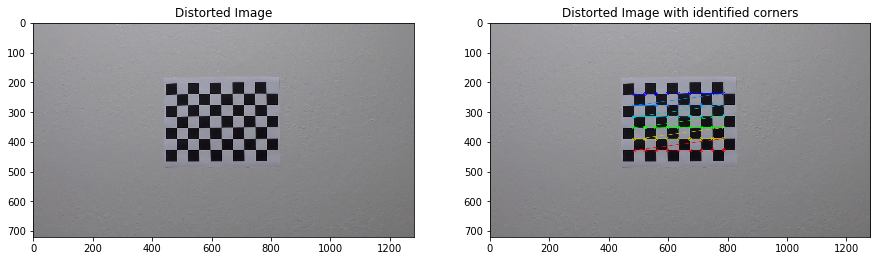

** debug: chess corners recognized for file ./camera_cal/calibration7.jpg


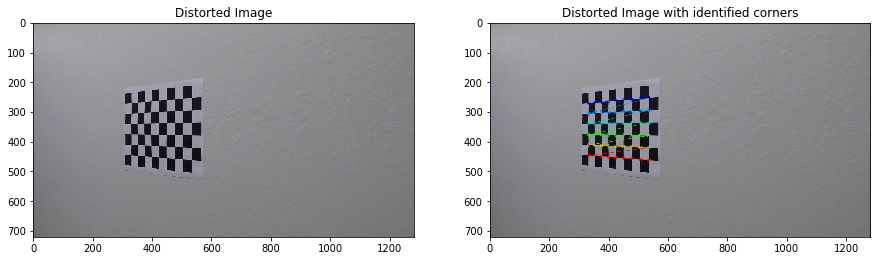

** debug: chess corners recognized for file ./camera_cal/calibration8.jpg


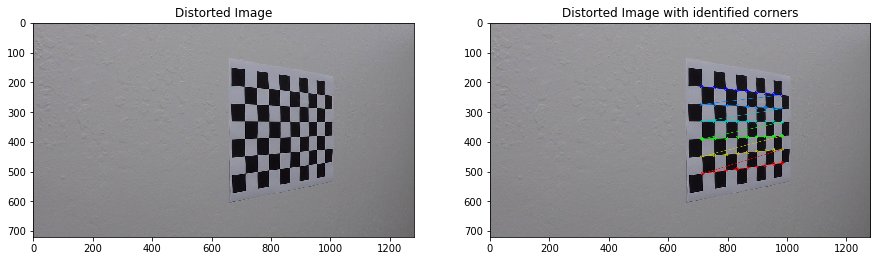

** debug: chess corners recognized for file ./camera_cal/calibration9.jpg


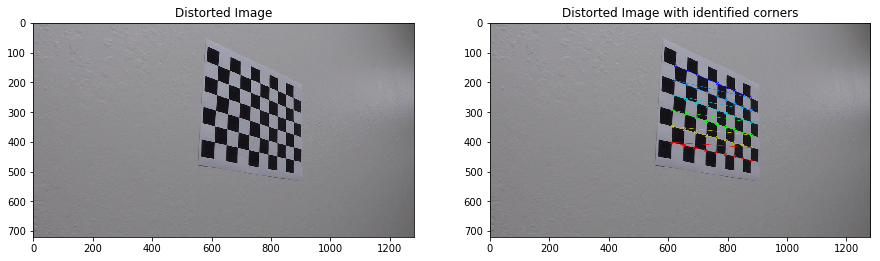


NOTE: not all chess corners have been identified: identified images 17 of 20



In [15]:
obj_l, img_l = runCalibration ("./camera_cal/*.jpg",9,6,2)


## Undistort of claibration images

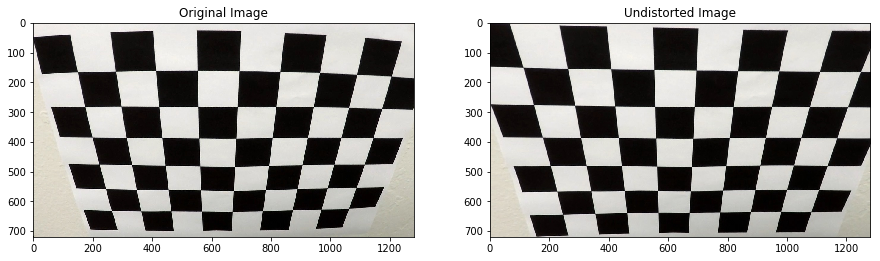

In [16]:
cal_und = runUndistort("./camera_cal/calibration2.jpg",obj_l,img_l, 1)

## B. Pipeline

### 1. Undistort - standalone

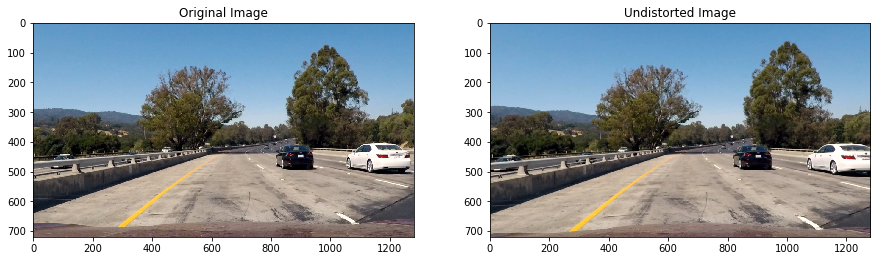

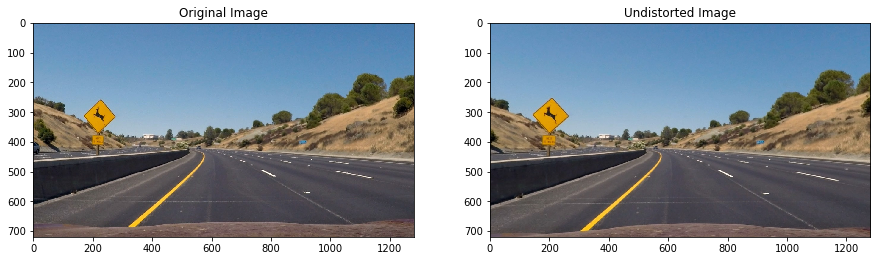

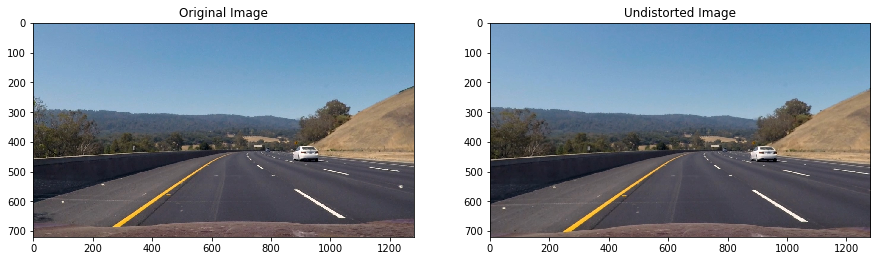

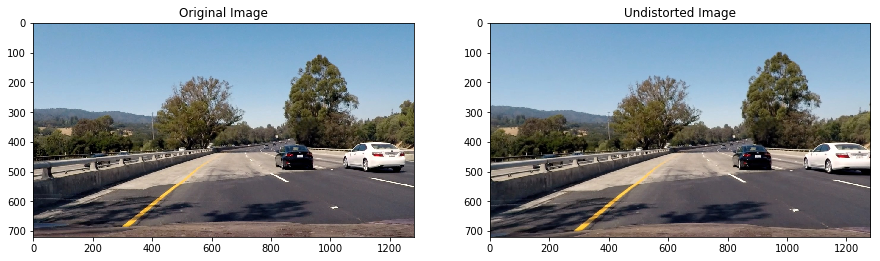

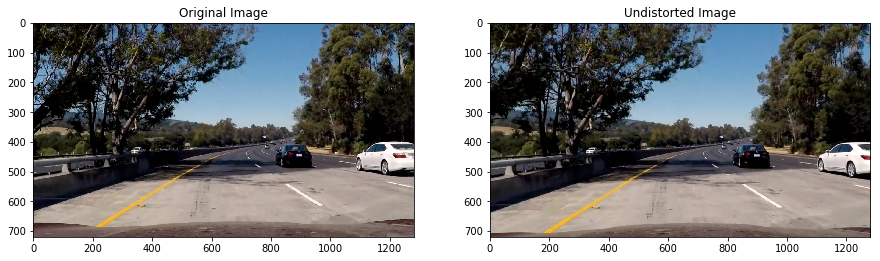

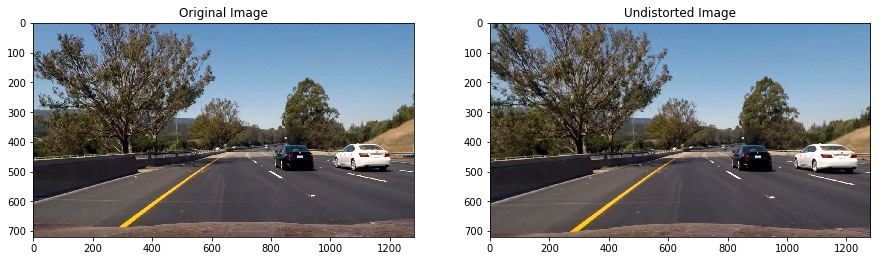

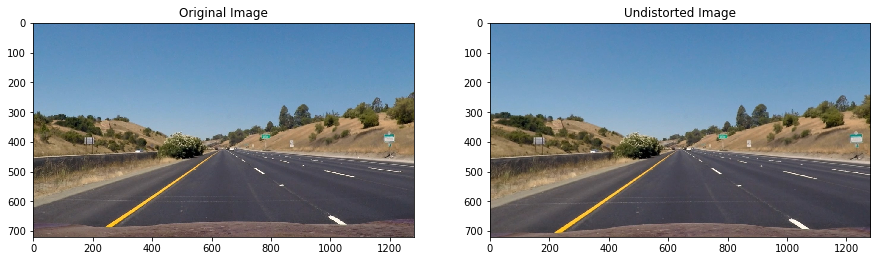

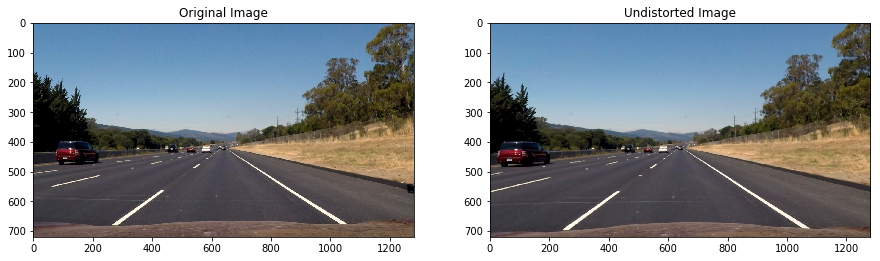

In [17]:
curve1    = runUndistort("./test_images/test1.jpg",obj_l,img_l, 1)
curve2    = runUndistort("./test_images/test2.jpg",obj_l,img_l, 1)
curve3    = runUndistort("./test_images/test3.jpg",obj_l,img_l, 1)
curve4    = runUndistort("./test_images/test4.jpg",obj_l,img_l, 1)
curve5    = runUndistort("./test_images/test5.jpg",obj_l,img_l, 1)
curve6    = runUndistort("./test_images/test6.jpg",obj_l,img_l, 1)
straight1 = runUndistort("./test_images/straight_lines1.jpg",obj_l,img_l, 1)
straight2 = runUndistort("./test_images/straight_lines2.jpg",obj_l,img_l, 1)

### 2. Pre-process images - standalone

In [85]:
curve1_p       = combinedAdvanced2(curve1,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
curve2_p       = combinedAdvanced2(curve2,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
curve3_p       = combinedAdvanced2(curve3,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
curve4_p       = combinedAdvanced2(curve4,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
curve5_p       = combinedAdvanced2(curve5,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
curve6_p       = combinedAdvanced2(curve6,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
straight1_p    = combinedAdvanced2(straight1,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))
straight2_p    = combinedAdvanced2(straight2,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(45,255))

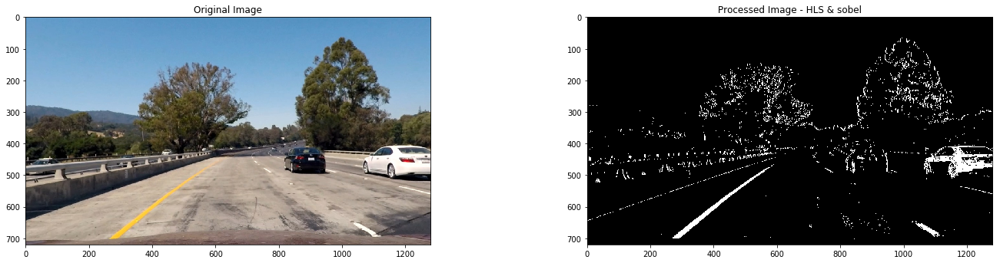

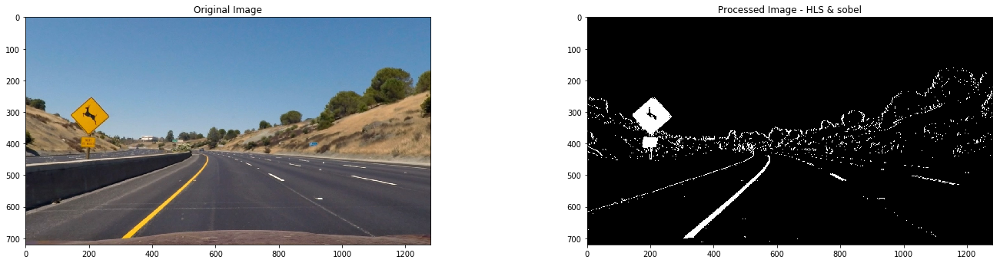

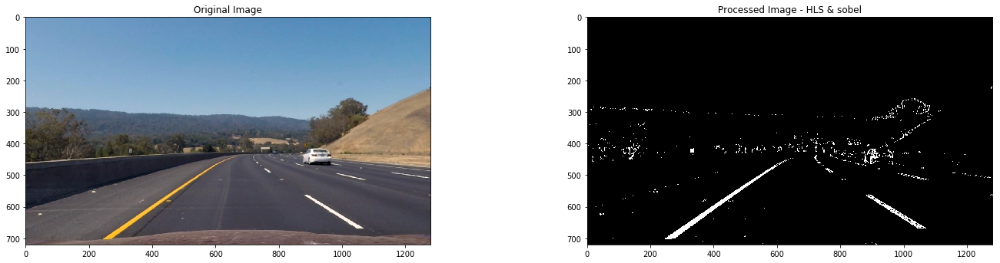

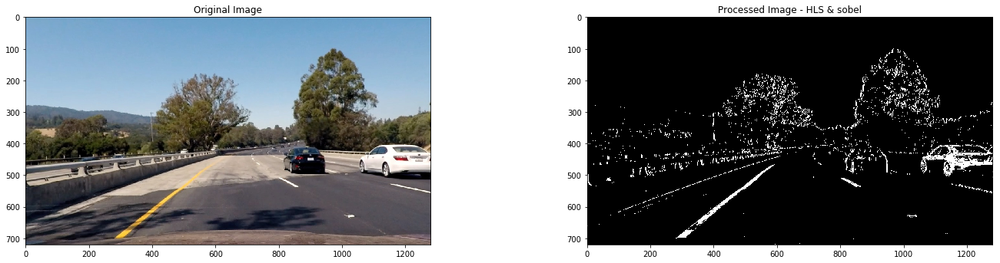

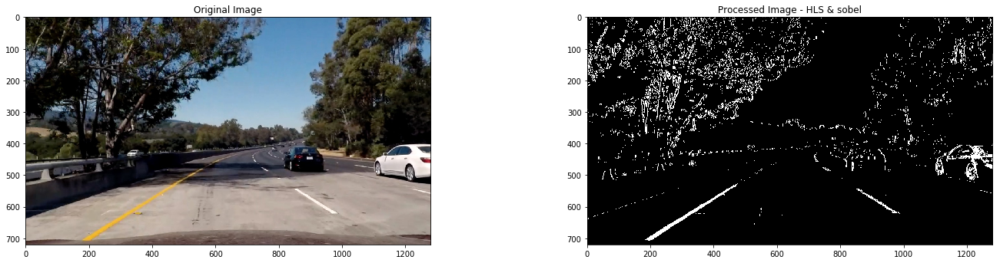

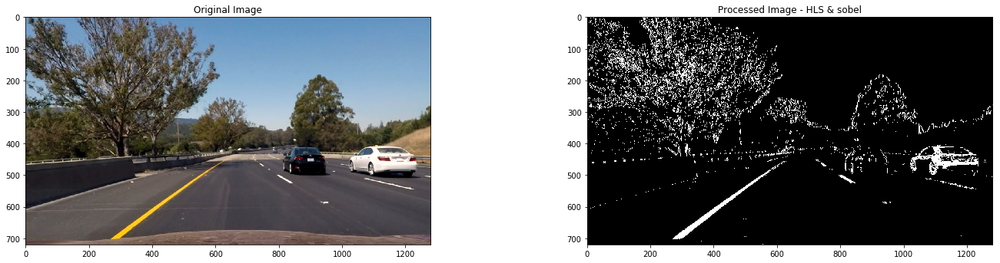

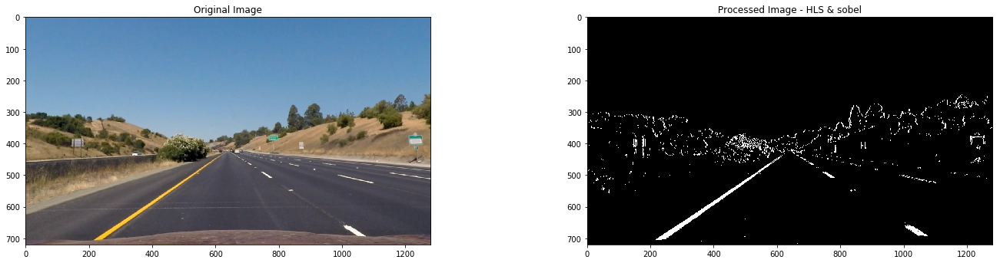

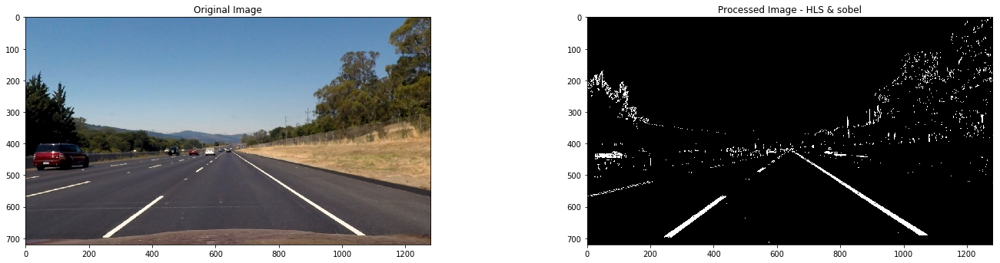

In [86]:
plt.rcParams["figure.figsize"] = [24, 12]
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve1)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve1_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve2)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve2_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve3)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve3_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve4)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve4_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve5)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve5_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(curve6)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(curve6_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(straight1)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(straight1_p,cmap='gray') 
plt.show()
sub = plt.subplot(2,2,1)
plt.title('Original Image')
plt.imshow(straight2)
sub = plt.subplot(2,2,2)
plt.title('Processed Image - HLS & sobel')
plt.imshow(straight2_p,cmap='gray') 
plt.show()

### Present impact for L-channel 

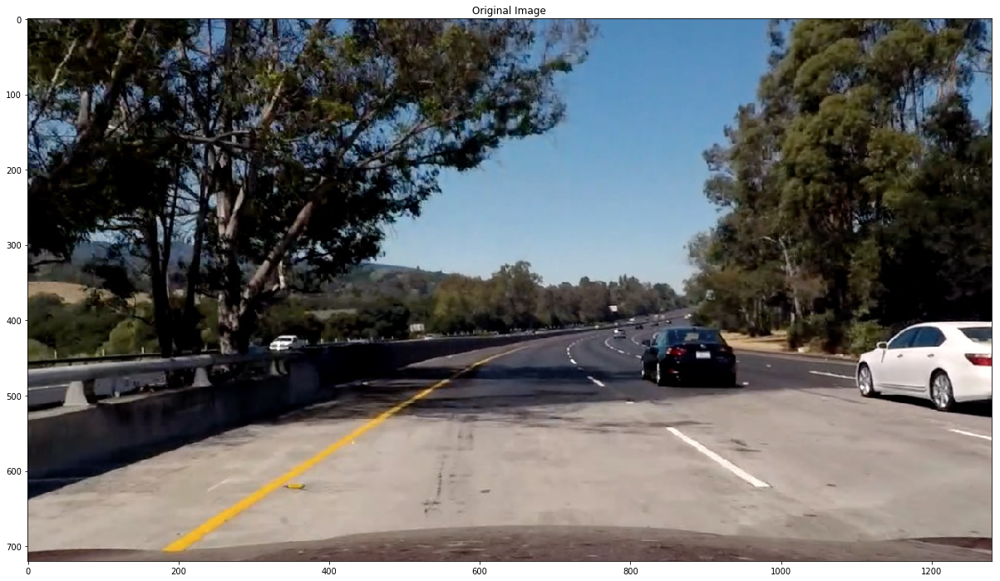

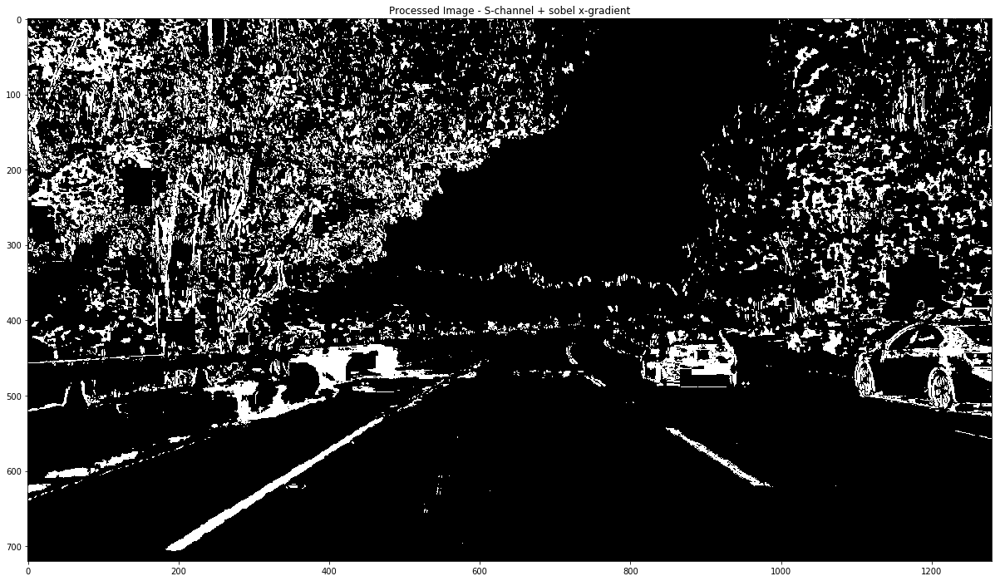

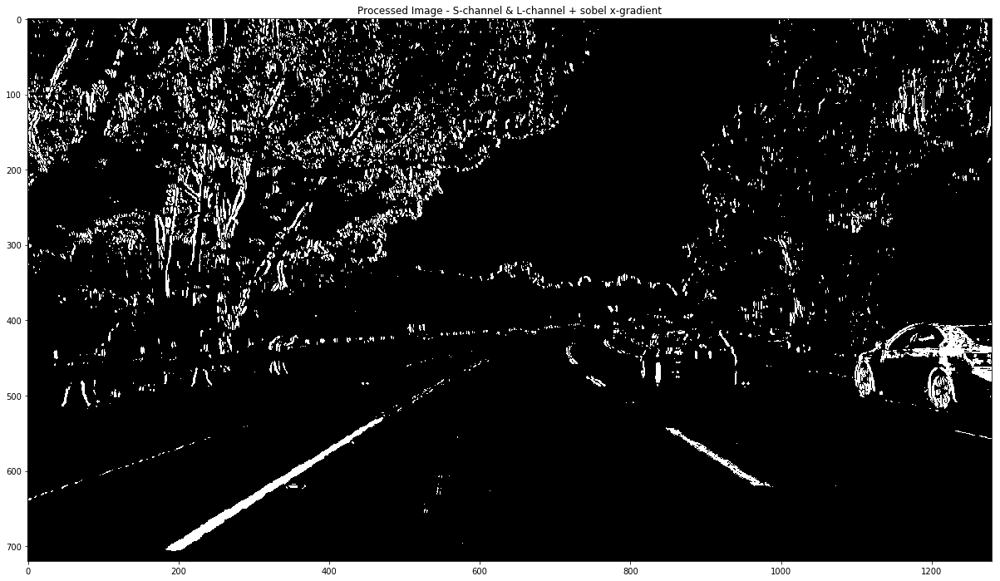

In [87]:
curve5_p1 = combinedAdvanced2(curve5,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(40,255))
curve5_p2 = combinedAdvanced(curve5, s_thresh=(155, 255), sx_thresh=(35, 255))

plt.rcParams["figure.figsize"] = [24, 12]
plt.title('Original Image')
plt.imshow(curve5)
plt.show()
plt.title('Processed Image - S-channel + sobel x-gradient')
plt.imshow(curve5_p2,cmap='gray') 
plt.show()
plt.title('Processed Image - S-channel & L-channel + sobel x-gradient')
plt.imshow(curve5_p1,cmap='gray')
plt.show()

### 3. Perspective Martix & Warp verification (B)

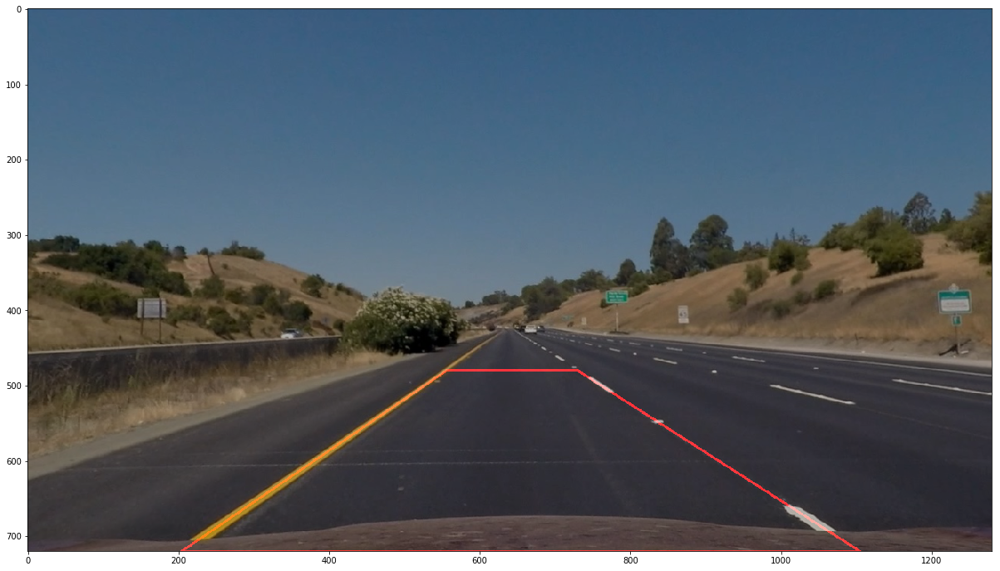

NOTE: SRC coordinates=
[[  204.   720.]
 [  556.   480.]
 [  730.   480.]
 [ 1105.   720.]]
NOTE: DST coordinates=
[[  204.   720.]
 [  204.     0.]
 [ 1105.     0.]
 [ 1105.   720.]]
NOTE: lane width [pixels]= 901


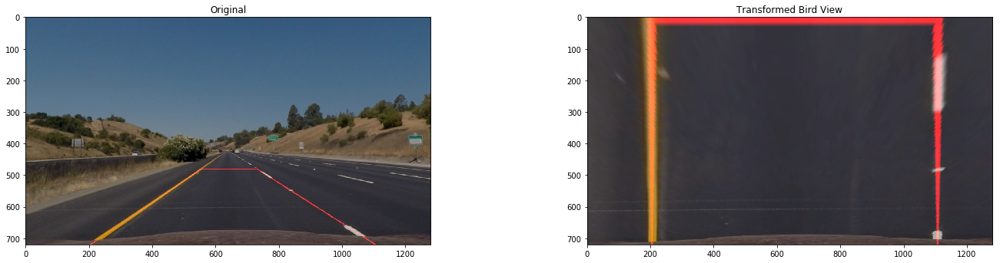

In [21]:
# Run Perspective matrix
m_image_und = runUndistort("./test_images/straight_lines1.jpg",obj_l,img_l, 0)
M, Minv = runPerspectiveMatrix(m_image_und,2)

### Run pipeline on test images


NOTE: not all chess corners have been identified: identified images 17 of 20



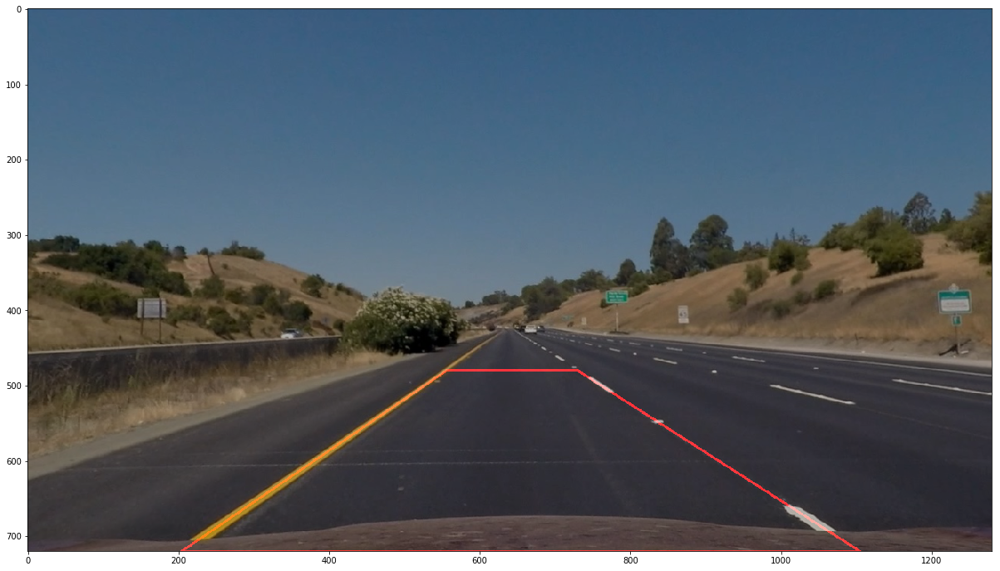

NOTE: SRC coordinates=
[[  204.   720.]
 [  556.   480.]
 [  730.   480.]
 [ 1105.   720.]]
NOTE: DST coordinates=
[[  204.   720.]
 [  204.     0.]
 [ 1105.     0.]
 [ 1105.   720.]]
NOTE: lane width [pixels]= 901


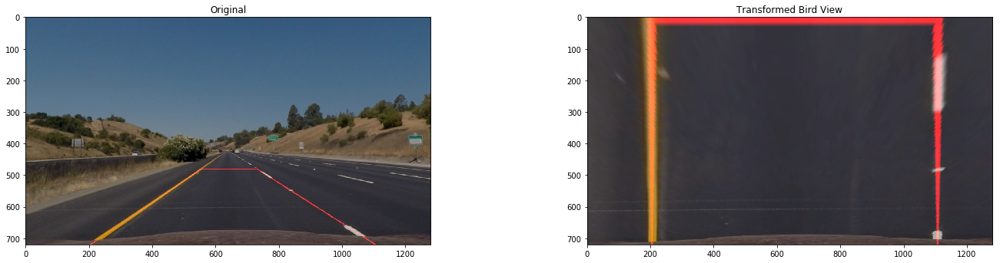

NOTE: processing file ./test_images/test1.jpg
NOTE: combinedAdvanced2(image_und,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(40,255)) 


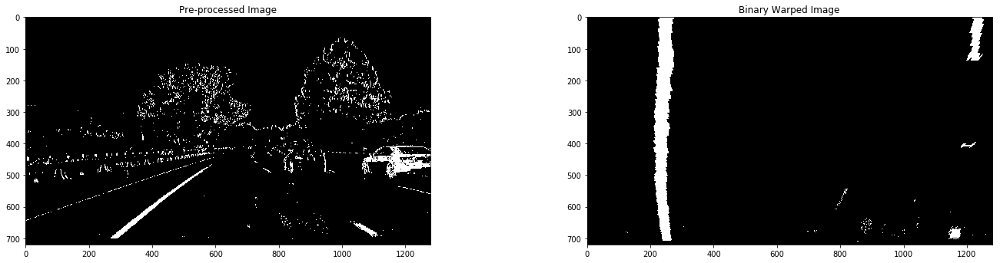

NOTE: reset @ frame = 1


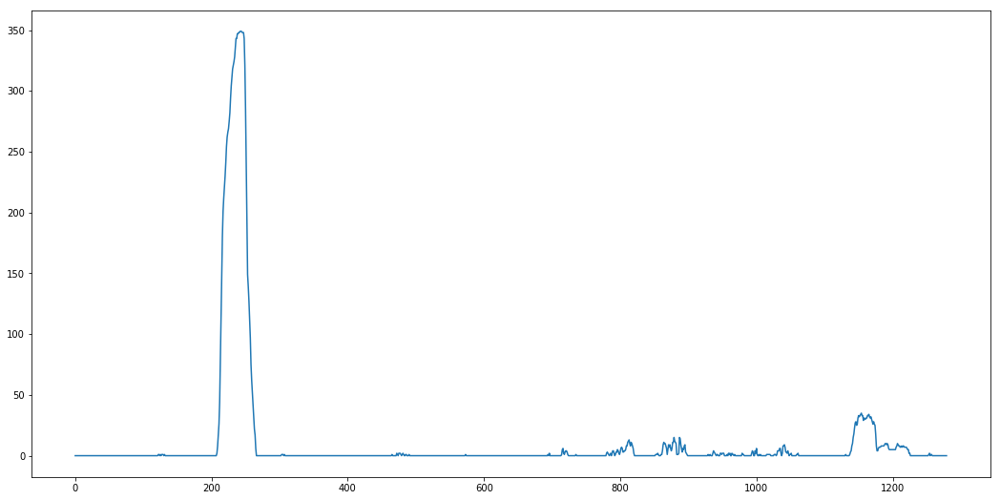

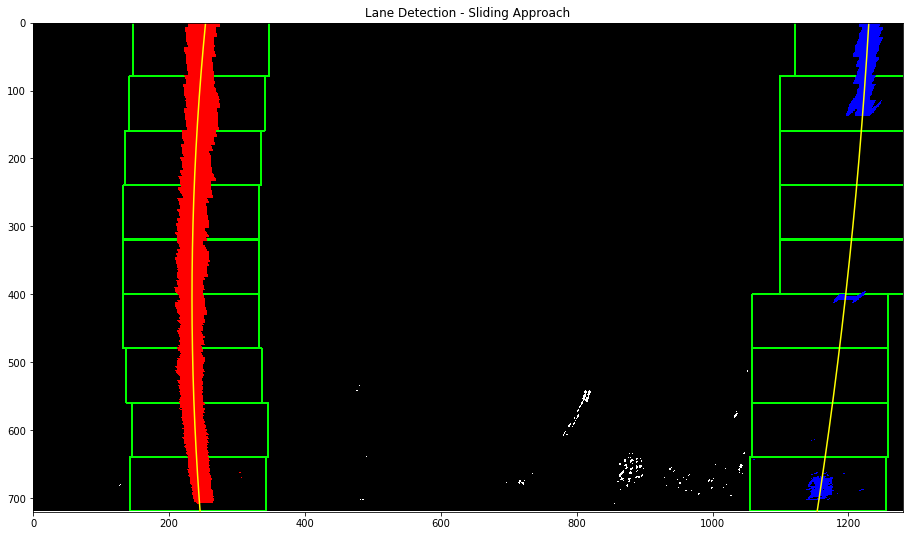

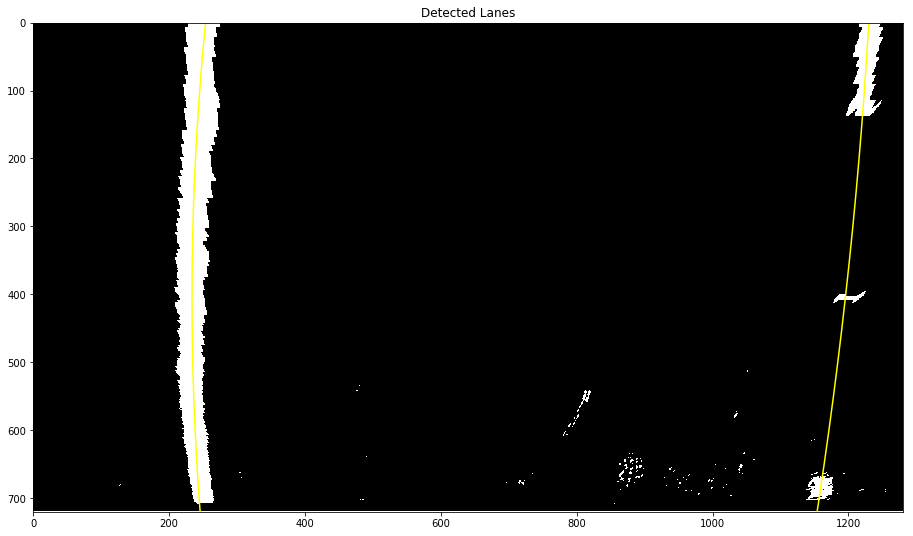

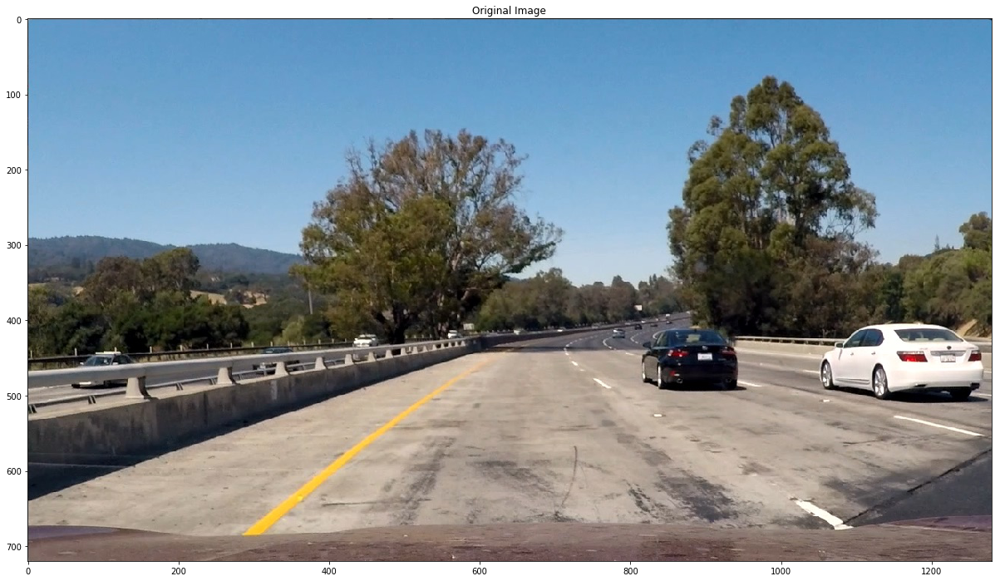

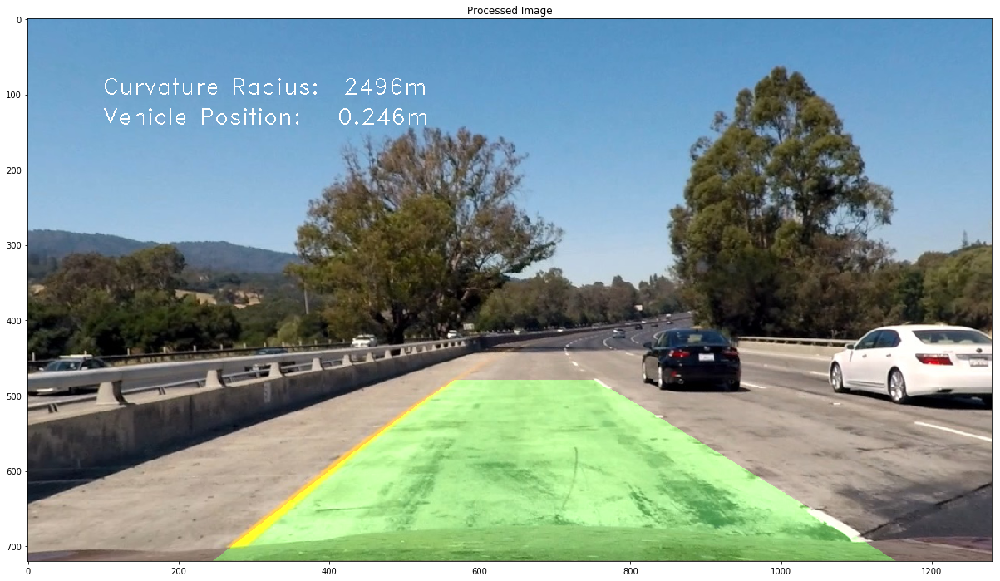

NOTE: processing file ./test_images/test2.jpg


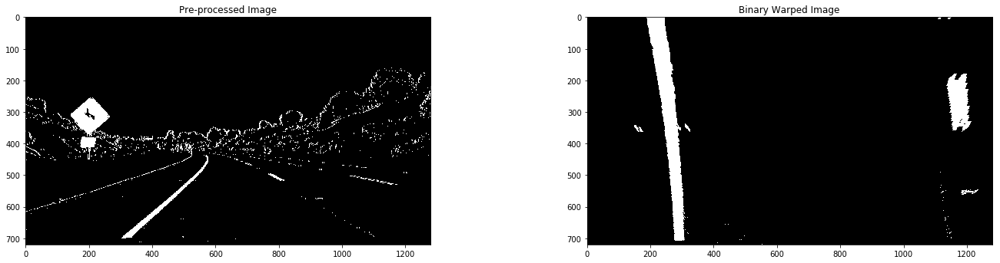

NOTE: reset @ frame = 2


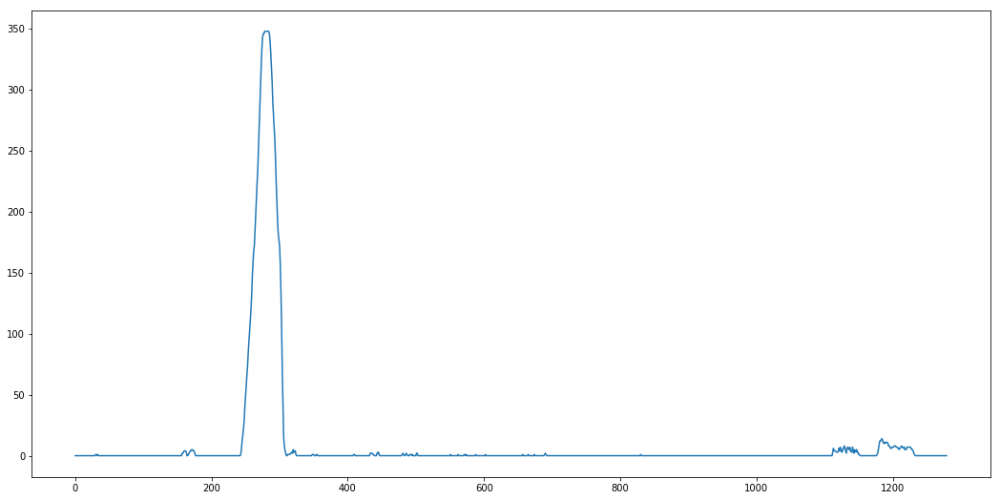

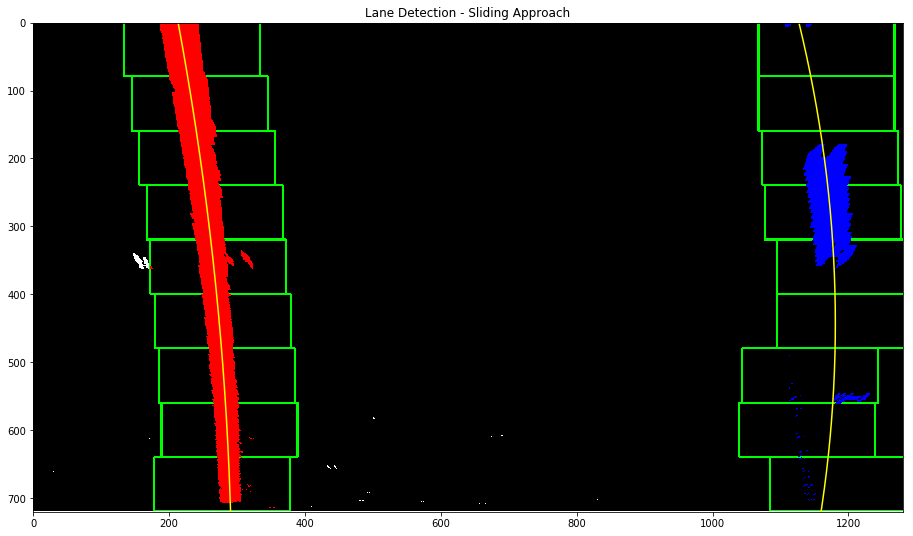

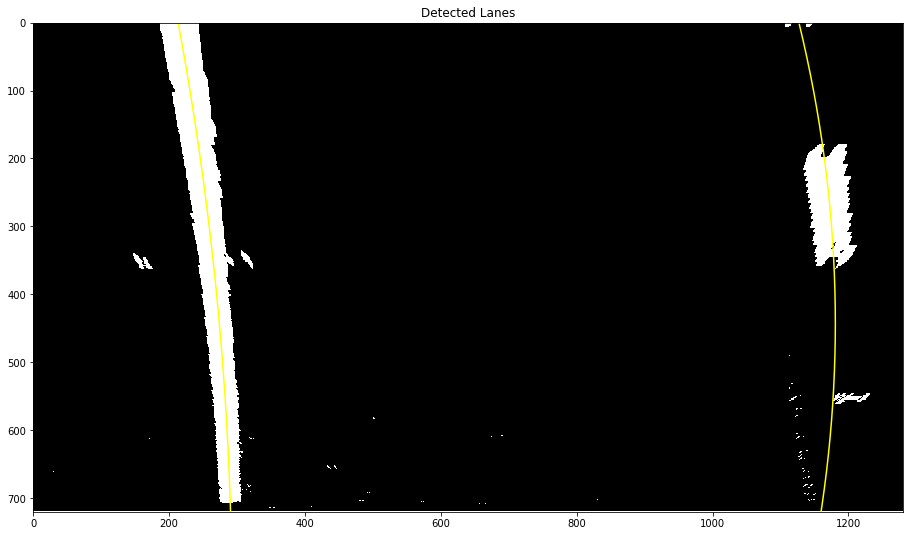

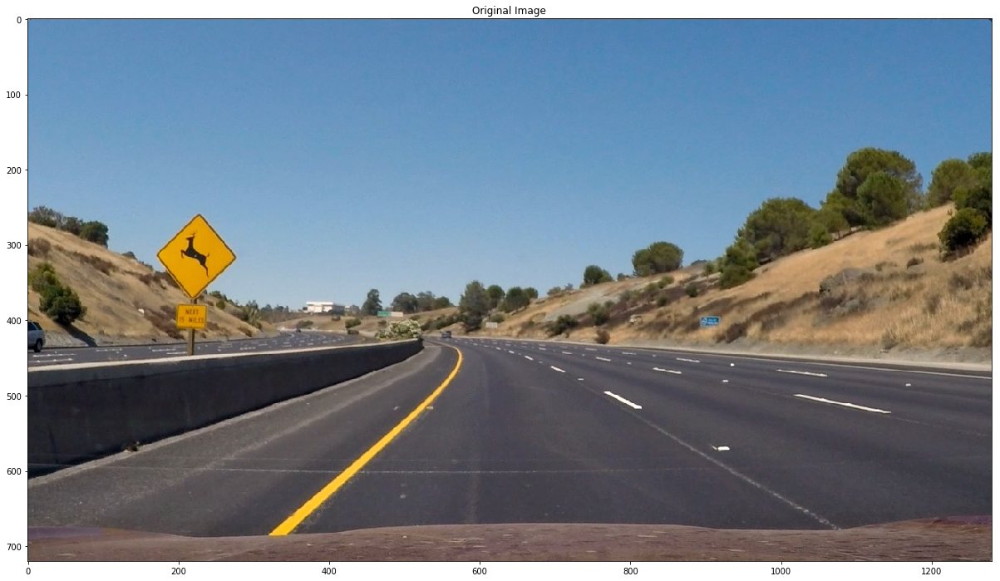

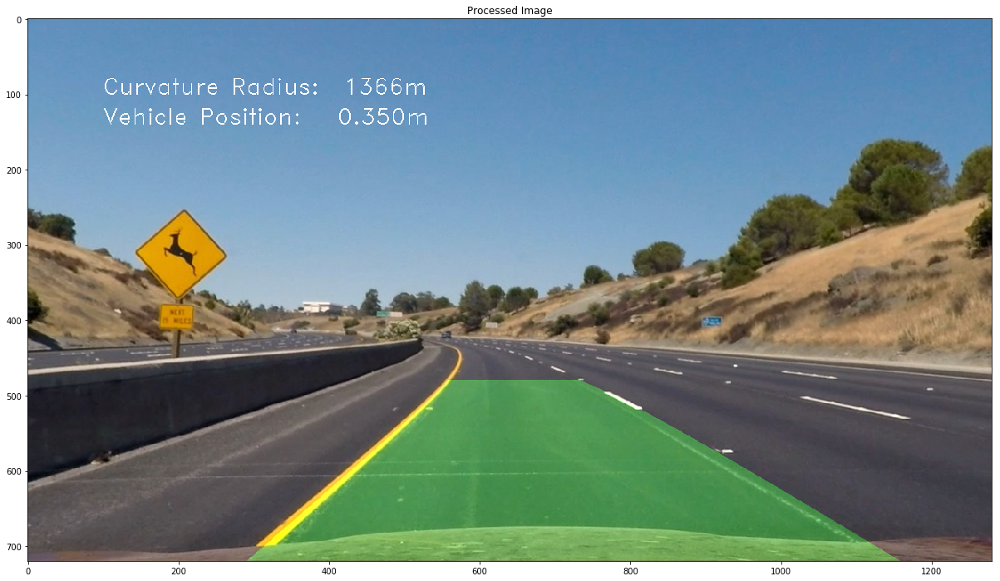

NOTE: processing file ./test_images/test3.jpg


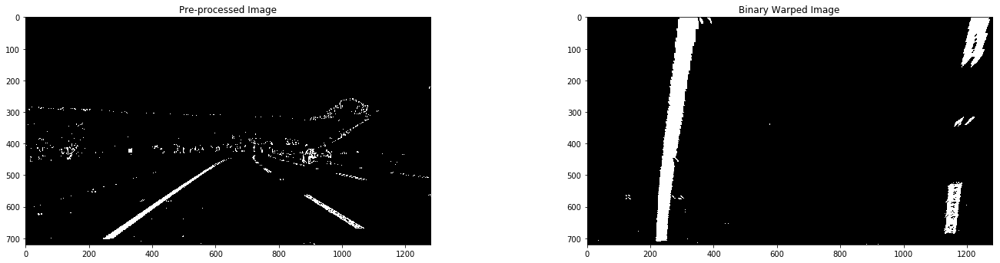

NOTE: reset @ frame = 3


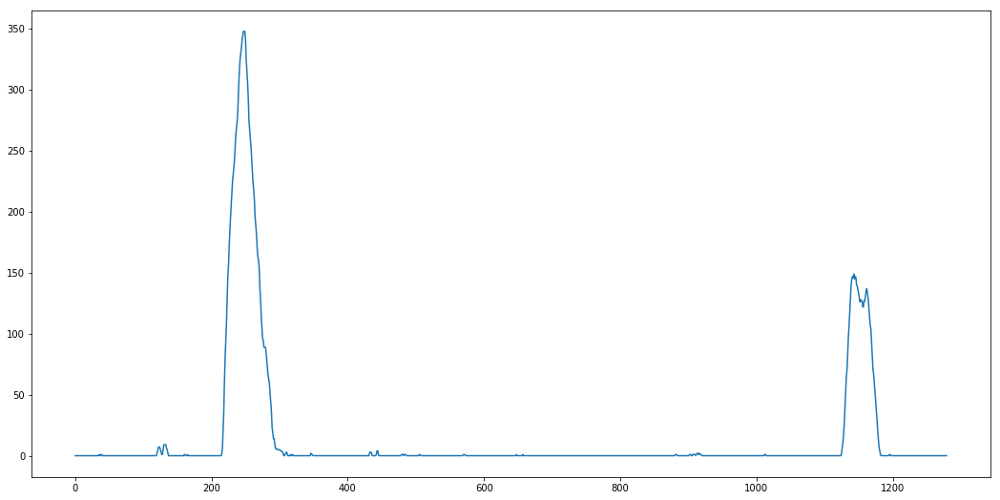

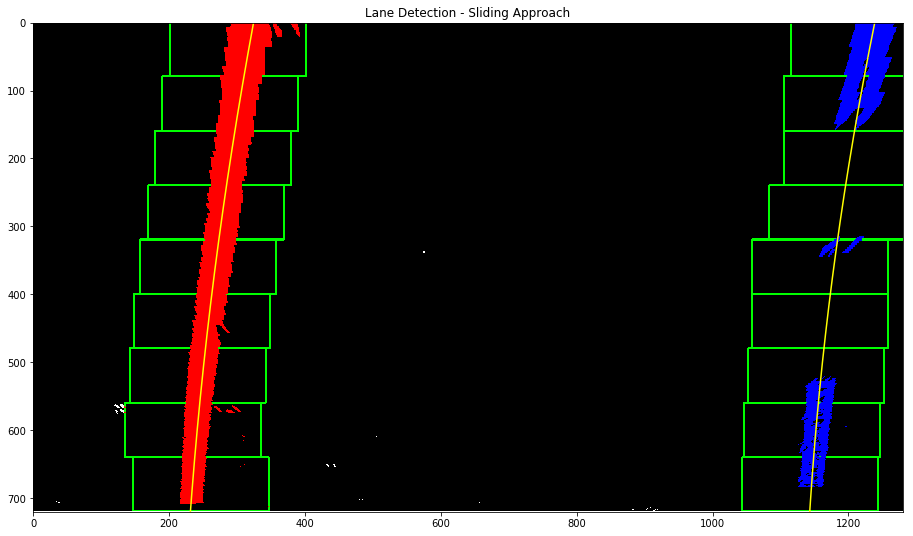

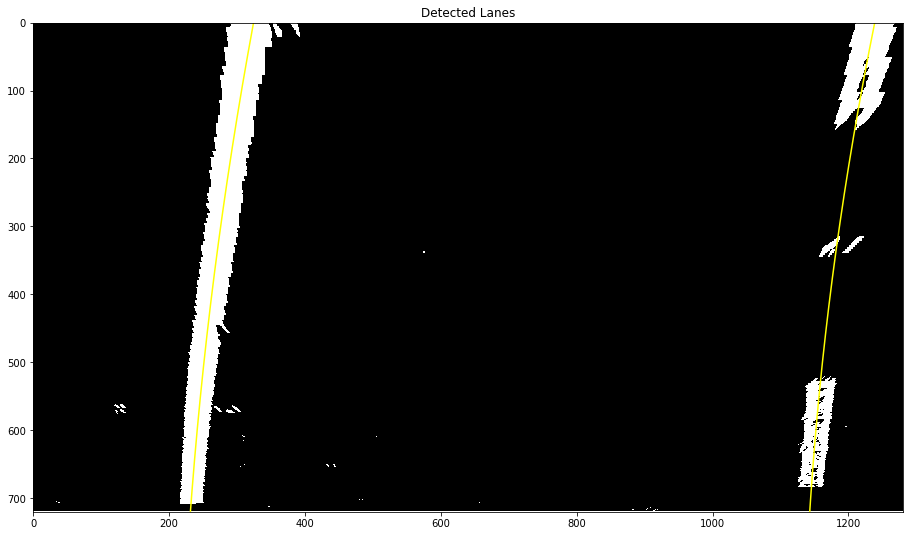

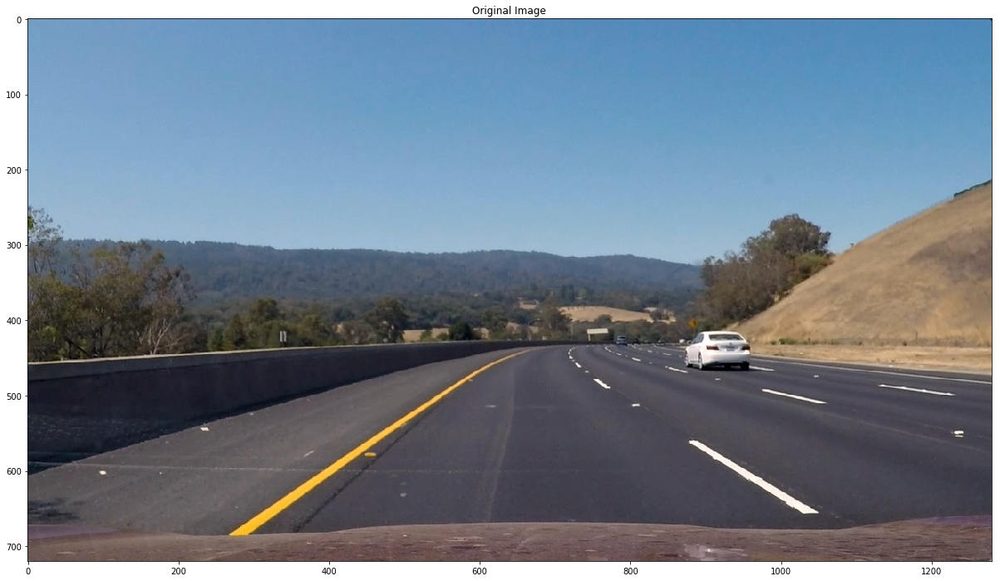

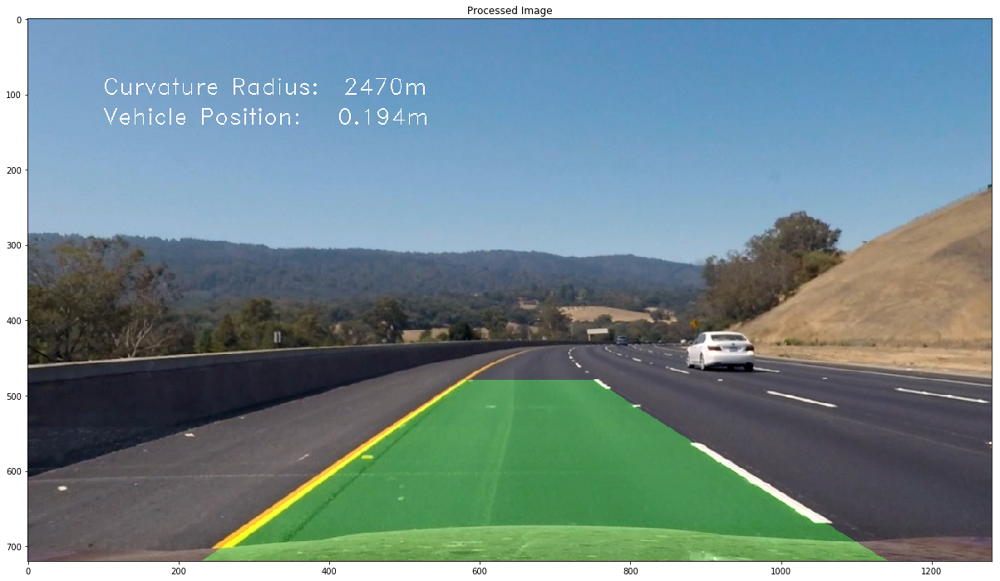

NOTE: processing file ./test_images/test4.jpg


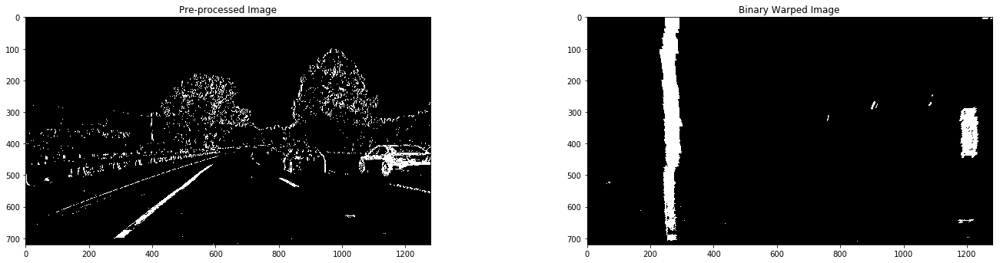

NOTE: reset @ frame = 4


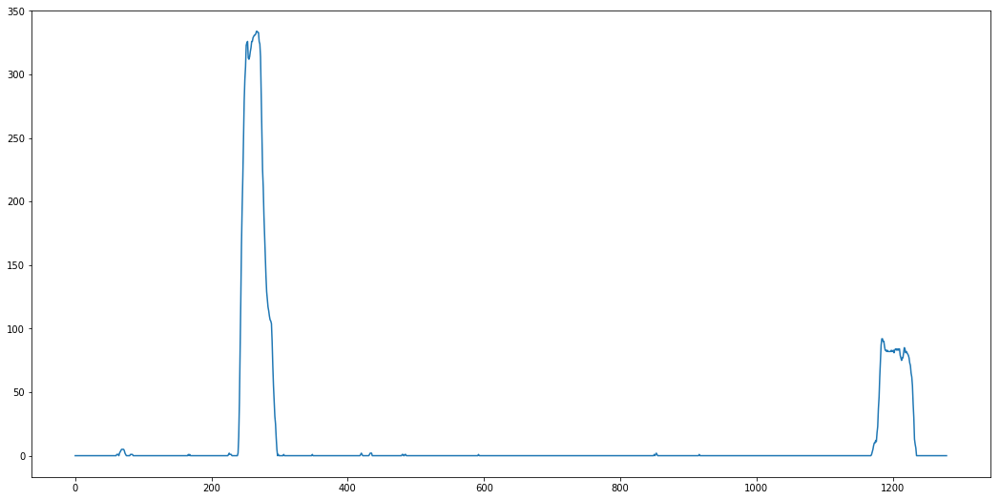

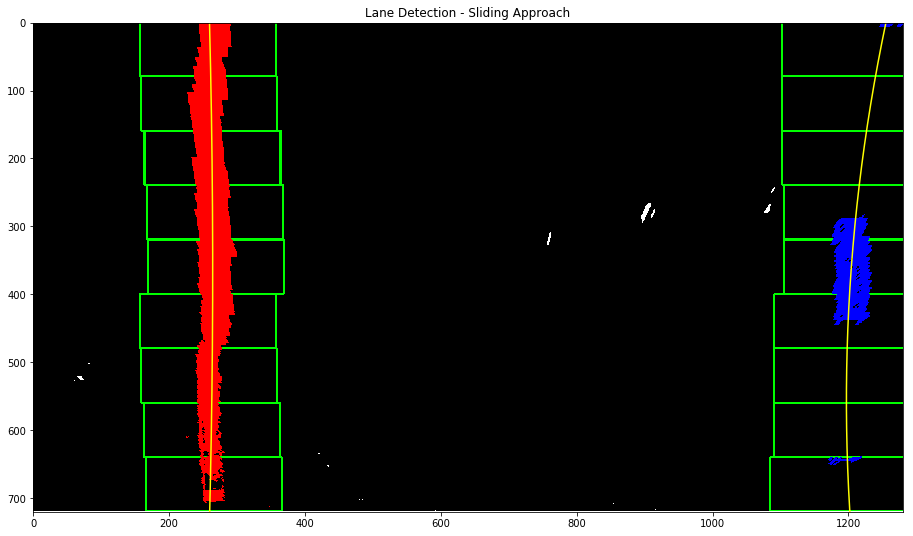

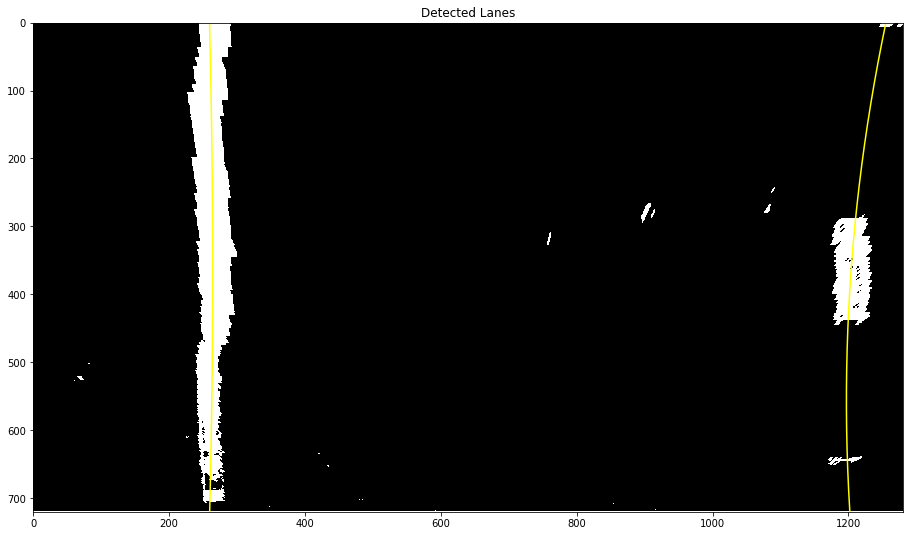

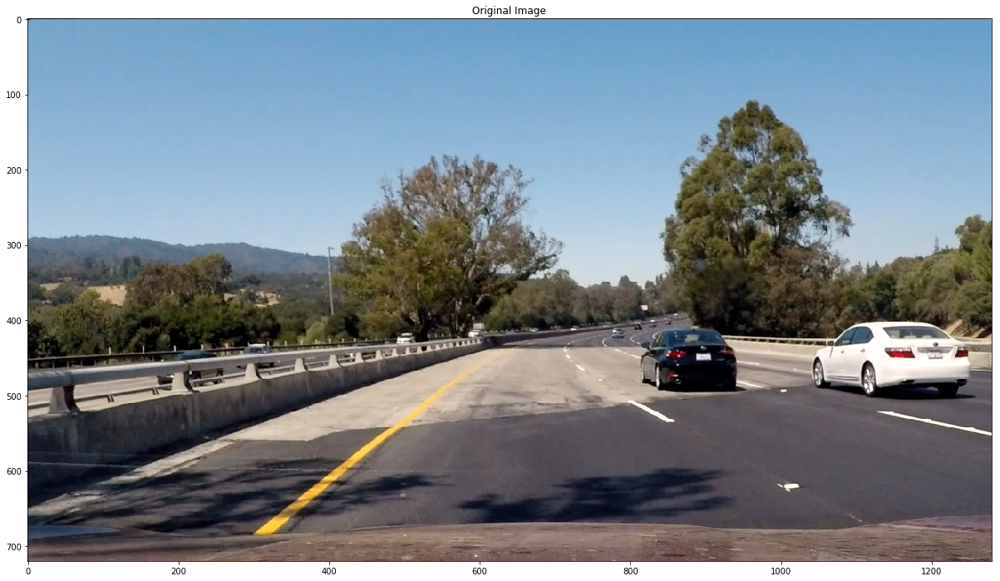

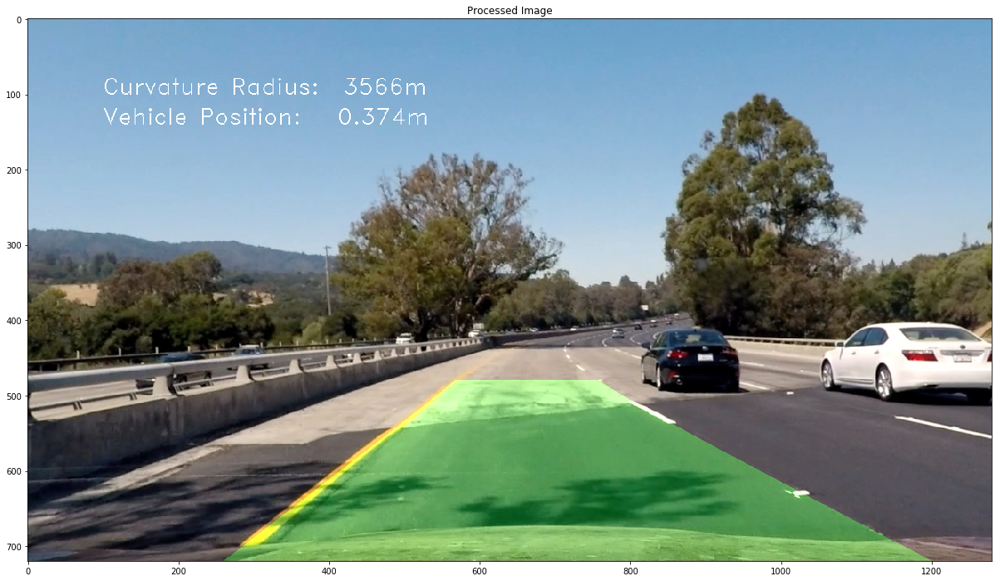

NOTE: processing file ./test_images/test5.jpg


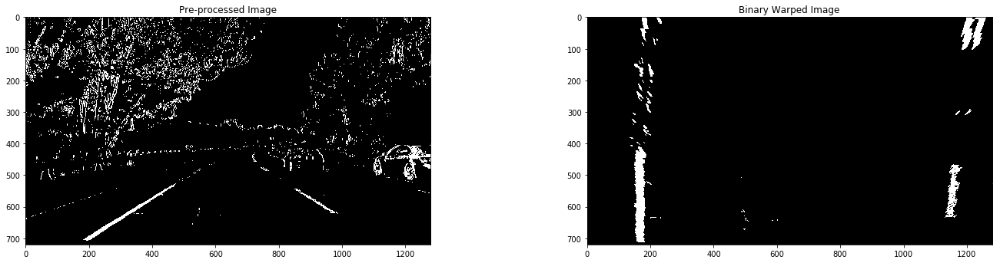

NOTE: reset @ frame = 5


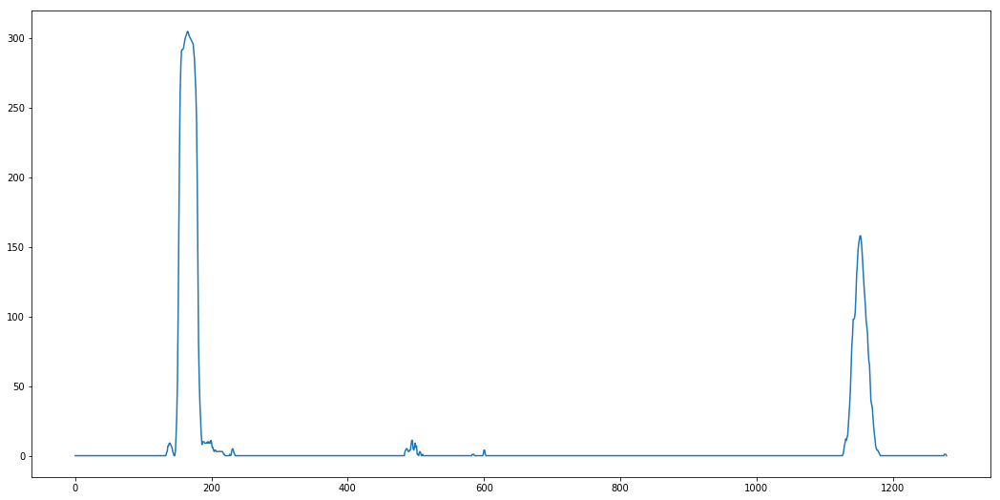

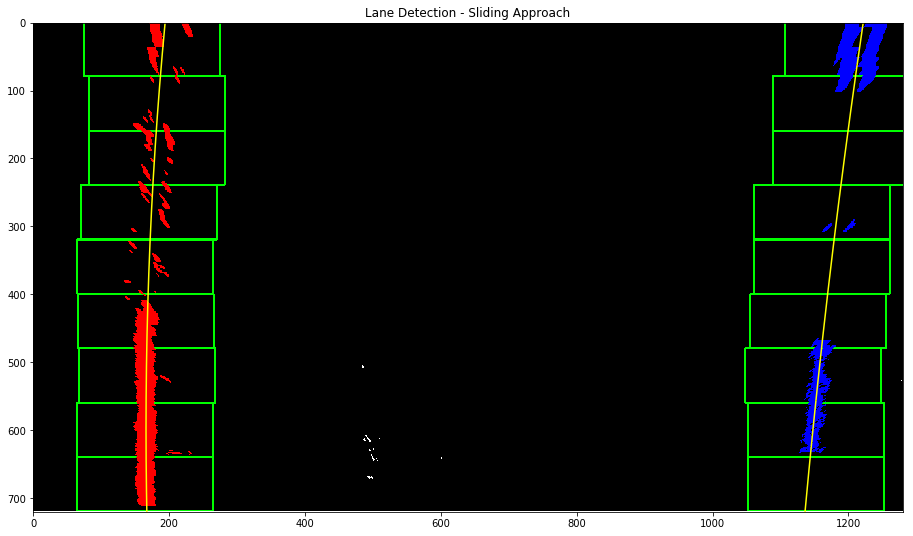

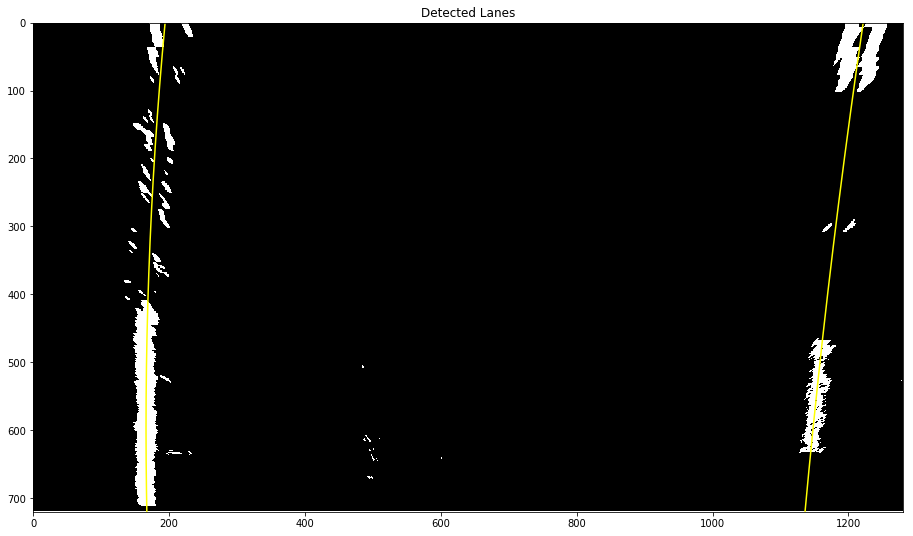

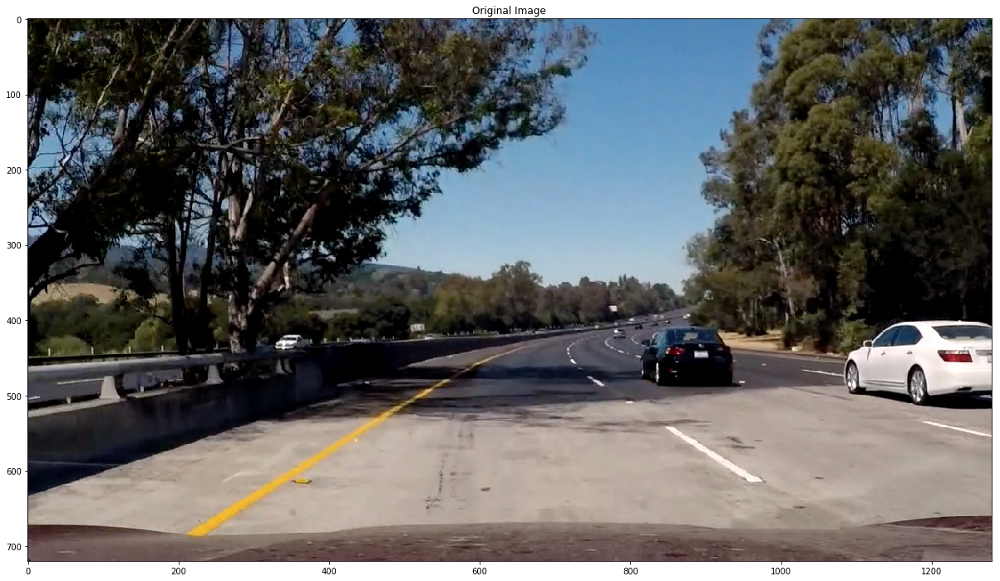

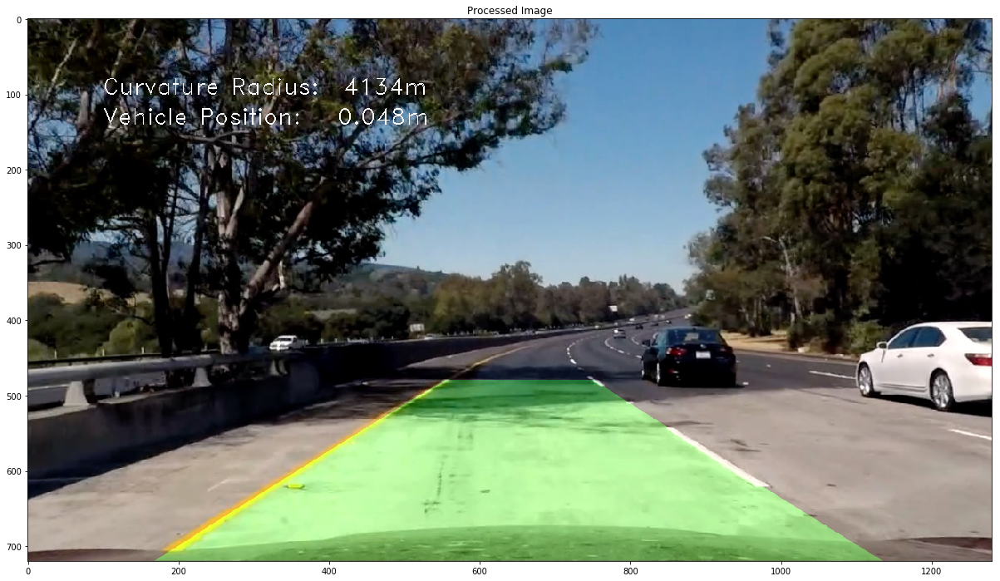

NOTE: processing file ./test_images/test6.jpg


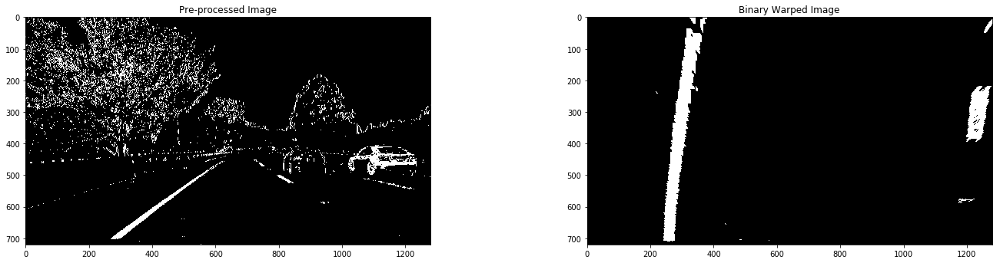

NOTE: reset @ frame = 6


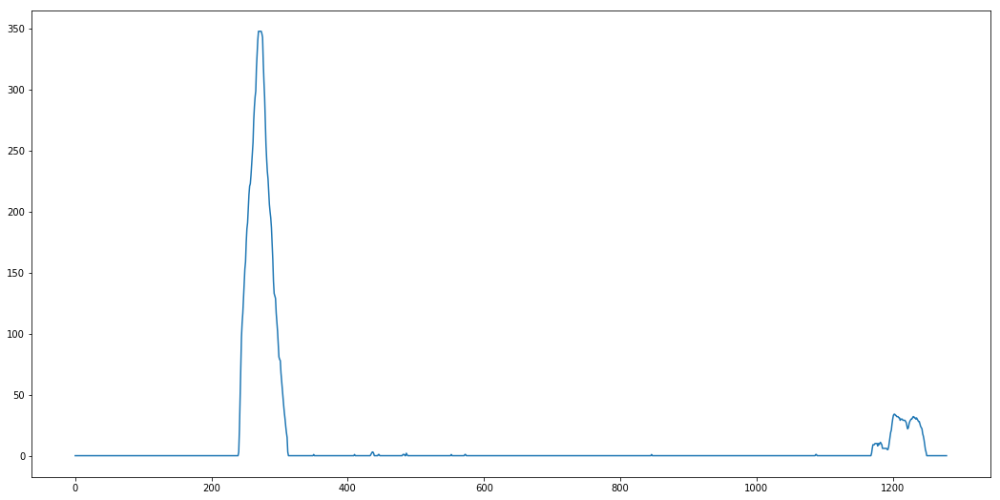

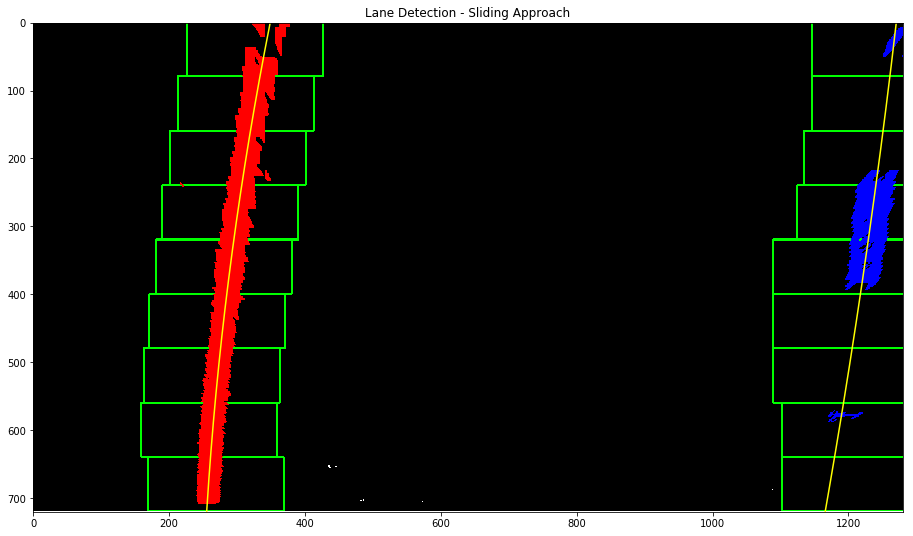

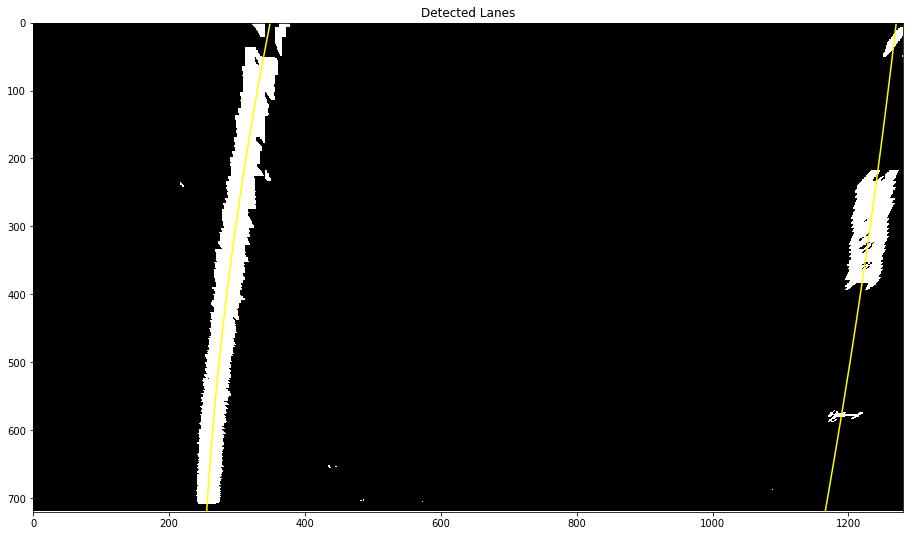

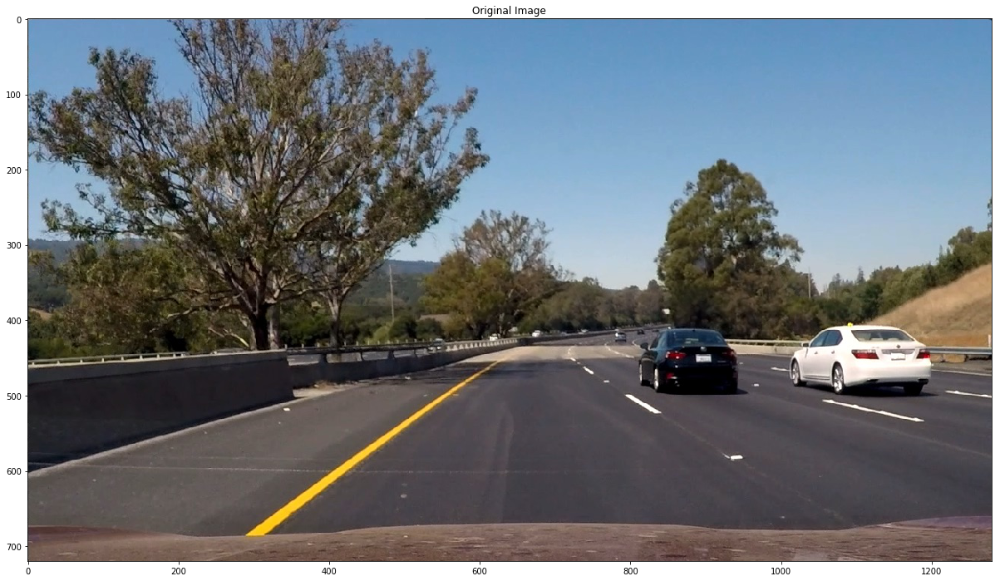

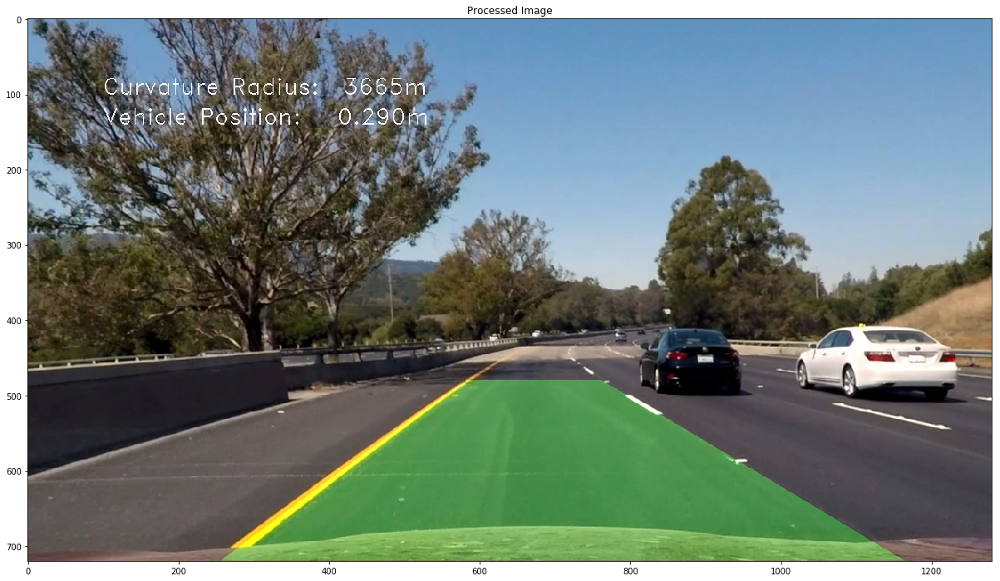

In [88]:
# location of test images
location =("./test_images/test*.jpg")
    
# get test images
images = glob.glob(location)
    
# Run calibration on chessboard corners
obj_l, img_l = runCalibration ("./camera_cal/*.jpg",9,6,0)

# Run Perspective matrix
m_image_und = runUndistort("./test_images/straight_lines1.jpg",obj_l,img_l, 0)
M, Minv = runPerspectiveMatrix(m_image_und,2)


step  = 0
reset = 1  # only run sliding

# Run over test files
for name in images :
    
    # incr. number
    step = step + 1
    
    # read name
    image = mpimg.imread(name)
       
    print ('NOTE: processing file',name)
    
    # pipeline
    reset = 1 # only sliding
    output = pipeLine (image, M, Minv, obj_l, img_l, step, debug = 1)
    
    # plot
    plt.rcParams["figure.figsize"] = [24, 12]
    #sub = plt.subplot(2,2,1)
    plt.title('Original Image')
    plt.imshow(image)
    plt.show()
    #sub = plt.subplot(2,2,2)
    plt.title('Processed Image')
    plt.imshow(output) 
    plt.show()
    
    

## C. Video

In [80]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

number = 0
reset  = 1

In [81]:
def process_image(image):
    # NOTE: The output you return should be a color image (3 channel) for processing video below
    # TODO: put your pipeline here,
    # you should return the final output (image where lines are drawn on lanes)
    global number
    
    number = number + 1
    ########################################################
    # Run pipeline for videos comment out/in according video
    ########################################################
    output = pipeLine (image, M, Minv, obj_l, img_l,number)
    
    return output

In [82]:
white_output = 'project_video_processed-ok.mp4'
clip1 = VideoFileClip("project_video.mp4")
white_clip = clip1.fl_image(process_image) #NOTE: this function expects color images!!
%time white_clip.write_videofile(white_output, audio=False)

NOTE: combinedAdvanced2(image_und,s_thresh=(155, 255), sx_thresh=(35, 255), l_thresh=(40,255)) 
NOTE: reset @ frame = 1
[MoviePy] >>>> Building video project_video_processed-ok.mp4
[MoviePy] Writing video project_video_processed-ok.mp4



 12%|█▏        | 152/1261 [02:13<15:44,  1.17it/s]


 24%|██▍       | 303/1261 [04:22<13:03,  1.22it/s]


 36%|███▌      | 454/1261 [06:26<12:41,  1.06it/s]


 48%|████▊     | 605/1261 [08:29<09:24,  1.16it/s]


 60%|█████▉    | 756/1261 [10:32<06:58,  1.21it/s]


 72%|███████▏  | 907/1261 [12:36<04:47,  1.23it/s]


 84%|████████▍ | 1057/1261 [14:39<02:47,  1.22it/s]


 96%|█████████▌| 1205/1261 [16:41<00:49,  1.13it/s]


100%|█████████▉| 1260/1261 [17:26<00:00,  1.23it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_processed-ok.mp4 

CPU times: user 17min 24s, sys: 1min 4s, total: 18min 28s
Wall time: 17min 28s
